##       Develop ML Prediction Model for early detection of Sepsis using MIMIC-III ICU Datasets

Sepsis is a life-threatening condition that occurs when the body's response to infection causes tissue damage, organ failure, or death (Singer et al., 2016). In the U.S., nearly 1.7 million people develop sepsis and 270,000 people die from sepsis each year; over one third of people who die in U.S. hospitals have sepsis (CDC). 
Internationally, an estimated 30 million people develop sepsis and 6 million people die from sepsis each year; an estimated 4.2 million newborns and children are affected (WHO). Sepsis costs U.S. hospitals more than any other health condition at $24 billion (13% of U.S. healthcare expenses) a year, and a majority of these costs are for sepsis patients that were not diagnosed at admission (Paoli et al., 2018). Sepsis costs are even greater globally with the developing world at most risk. Altogether, sepsis is a major public health issue responsible for significant morbidity, mortality, and healthcare expenses.

##### Dataset (https://mimic.mit.edu/docs/iii/)

MIMIC-III (Medical Information Mart for Intensive Care III) is a large, freely-available database comprising
deidentified health-related data associated with over forty thousand patients who stayed in critical care units
of the Beth Israel Deaconess Medical Center between 2001 and 2012.
The database includes information such as demographics, vital sign measurements made at the bedside
(~1 data point per hour), laboratory test results, procedures, medications, caregiver notes, imaging reports,
and mortality (both in and out of hospital).

In [155]:
#  import the necessary libraries and load the files needed for Exploratory Data Analysis
import pandas as pd
import numpy as np
import seaborn as sns 
import matplotlib.pyplot as plt 
%matplotlib inline
from sklearn.model_selection import train_test_split, GridSearchCV 
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor 
from sklearn.linear_model import LogisticRegression 
from sklearn.metrics import accuracy_score, f1_score, classification_report, RocCurveDisplay, mean_squared_error, r2_score
import matplotlib.pyplot as plt
from sklearn.datasets import make_classification
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC

In [156]:
#Read the dataset
df=pd.read_csv(r'D:\Mostafa\Mimic\sepsis_data.csv')

In [157]:
df.head()

,subject_id,hadm_id,admission_type,admittime,dischtime,deathtime,hospital_expire_flag,diagnosis,marital_status,insurance,...,resprate_mean,tempc_min,tempc_max,tempc_mean,spo2_min,spo2_max,spo2_mean,glucose_min,glucose_max,glucose_mean
0,23804,100014,ELECTIVE,2111-03-05 03:42:00,2111-03-05 19:00:00,NaN,0,RIGHT SHOULDER ADHESIVE CAPSULITIS/SDA,SINGLE,Medicaid,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,68591,100016,EMERGENCY,2188-05-24 13:06:00,2188-05-30 17:16:00,NaN,0,PNEUMONIA,SINGLE,Medicare,...,17.153846,35.500000,36.666667,36.077778,94.0,100.0,97.680000,76.0,76.0,76.000000
2,9973,100020,EMERGENCY,2142-11-30 01:53:00,2142-12-10 16:32:00,NaN,0,HYPONATREMIA,MARRIED,Private,...,14.962963,35.166667,35.777778,35.416667,91.0,97.0,94.629630,79.0,101.0,90.000000
3,29971,100021,EMERGENCY,2109-08-17 10:55:00,2109-10-16 11:15:00,NaN,0,BILATERAL ANKLE FX; NEW AFLUTTER,MARRIED,Medicaid,...,21.400000,36.777776,37.111113,36.953704,94.0,100.0,98.200000,142.0,155.0,146.333333
4,29971,100021,EMERGENCY,2109-08-17 10:55:00,2109-10-16 11:15:00,NaN,0,BILATERAL ANKLE FX; NEW AFLUTTER,MARRIED,Medicaid,...,21.181818,36.388889,37.333332,36.874999,91.0,100.0,95.909091,105.0,159.0,121.800000


### Overview of Data

In [165]:
df.shape

(62477, 63)

In [163]:
df.columns

Index(['subject_id', 'hadm_id', 'admission_type', 'admittime', 'dischtime',
       'deathtime', 'hospital_expire_flag', 'diagnosis', 'marital_status',
       'insurance', 'language', 'religion', 'ethnicity', 'gender', 'dob',
       'los_icu', 'callout_count', 'diag_count', 'pres_count', 'proc_count',
       'cpt_count', 'lab_count', 'inputs_cv_count', 'inputs_mv_count',
       'output_count', 'transfer_count', 'micro_count', 'sepsis',
       'organ_failure', 'cardiovascular', 'renal', 'hepatic', 'hematologic',
       'metabolic', 'neurologic', 'heartrate_min', 'heartrate_max',
       'heartrate_mean', 'sysbp_min', 'heartrate_min-2', 'heartrate_max-2',
       'heartrate_mean-2', 'sysbp_min-2', 'sysbp_max', 'sysbp_mean',
       'diasbp_min', 'diasbp_max', 'diasbp_mean', 'meanbp_min', 'meanbp_max',
       'meanbp_mean', 'resprate_min', 'resprate_max', 'resprate_mean',
       'tempc_min', 'tempc_max', 'tempc_mean', 'spo2_min', 'spo2_max',
       'spo2_mean', 'glucose_min', 'glucose_max', '

In [164]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62477 entries, 0 to 62476
Data columns (total 63 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   subject_id            62477 non-null  int64  
 1   hadm_id               62477 non-null  int64  
 2   admission_type        62477 non-null  object 
 3   admittime             62477 non-null  object 
 4   dischtime             62477 non-null  object 
 5   deathtime             6624 non-null   object 
 6   hospital_expire_flag  62477 non-null  int64  
 7   diagnosis             62452 non-null  object 
 8   marital_status        52155 non-null  object 
 9   insurance             62477 non-null  object 
 10  language              35933 non-null  object 
 11  religion              61995 non-null  object 
 12  ethnicity             62477 non-null  object 
 13  gender                62477 non-null  object 
 14  dob                   62477 non-null  object 
 15  los_icu            

In [160]:
# Saving a copy of the data 
dfAll = df

In [162]:
# By default , python displays few rows and columns. 
# Set the below parameters so that all rows and columns would be visible
pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", None)
df.isna().sum()

subject_id                  0
hadm_id                     0
admission_type              0
admittime                   0
dischtime                   0
deathtime               55853
hospital_expire_flag        0
diagnosis                  25
marital_status          10322
insurance                   0
language                26544
religion                  482
ethnicity                   0
gender                      0
dob                         0
los_icu                  1200
callout_count           31225
diag_count                  0
pres_count               8985
proc_count               6796
cpt_count               15047
lab_count                 825
inputs_cv_count         28532
inputs_mv_count         39055
output_count             7010
transfer_count              0
micro_count             10334
sepsis                      0
organ_failure               0
cardiovascular              0
renal                       0
hepatic                     0
hematologic                 0
metabolic 

##### Analysis of Missing Values

<Axes: >

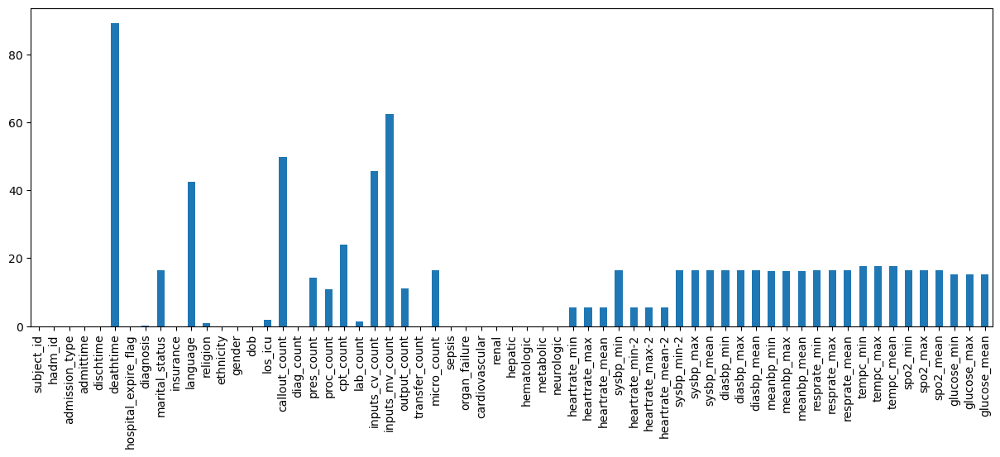

In [168]:
#cisualize the missing data by column name 
round(100*(df.isnull().sum()/len(df.index)),2).plot.bar(figsize=(15,5))

In [170]:
#showing the missing data %
df.isna().sum(axis = 0).sort_values(ascending=False) / len(df) * 100

deathtime               89.397698
inputs_mv_count         62.511004
callout_count           49.978392
inputs_cv_count         45.668006
language                42.486035
cpt_count               24.084063
tempc_max               17.758535
tempc_min               17.758535
tempc_mean              17.758535
micro_count             16.540487
marital_status          16.521280
resprate_min            16.402836
resprate_mean           16.402836
resprate_max            16.402836
spo2_min                16.396434
spo2_max                16.396434
spo2_mean               16.396434
diasbp_min              16.366023
diasbp_mean             16.366023
diasbp_max              16.366023
sysbp_mean              16.362822
sysbp_min               16.362822
sysbp_min-2             16.362822
sysbp_max               16.362822
meanbp_mean             16.308401
meanbp_max              16.308401
meanbp_min              16.308401
glucose_mean            15.183187
glucose_min             15.183187
glucose_max   

In [172]:
#unique values for each column 
df.nunique()

subject_id              46520
hadm_id                 58976
admission_type              4
admittime               58651
dischtime               58657
deathtime                5834
hospital_expire_flag        2
diagnosis               15691
marital_status              7
insurance                   5
language                   75
religion                   20
ethnicity                  41
gender                      2
dob                     32540
los_icu                 39223
callout_count               7
diag_count                 39
pres_count                597
proc_count                 39
cpt_count                 206
lab_count                2712
inputs_cv_count          3535
inputs_mv_count          1445
output_count             1078
transfer_count             24
micro_count               245
sepsis                      2
organ_failure               2
cardiovascular              2
renal                       2
hepatic                     2
hematologic                 2
metabolic 

### Data Preparation: Pre-processing Data

Our next step involves pre-processing the data to prepare it for modeling. Additionally, we'll perform feature engineering, which involves creating new variables or transforming existing ones to enhance the predictive power of our model. There are five main types of feature engineering:

- Creating: This involves generating new features from existing ones if they provide additional value in predicting our outcome. For example, we can create the age of a patient from their date of birth and admission date.

- Converting: The raw dataset may not be directly suitable for modeling. We often need to convert or normalize features to meet the model's input requirements. This typically involves converting all data types to numerical values for mathematical computation.

- Completing: Many models require complete input variables without any missing values to function properly. If there are missing values in the dataset, we may need to handle them by either estimating missing values, excluding variables with missing data, or excluding samples with missing values.

- Correcting: It's common to encounter errors or inaccurate values in a dataset. We should aim to correct these values or exclude samples with errors. One approach is to identify and address outliers within features.

- Correlating: Redundant information within the input variable set can hinder the model training process and may lead to poorer performance. Therefore, it's essential to perform basic statistical analysis to determine which features significantly contribute to our target variable. This analysis applies to both numerical and categorical features in the dataset.









1- As HOSPITAL_EXPIRE_FLAG indicates in-hospital death (see MIMIC's documentation)
Let's rename the variable HOSPITAL_EXPIRE_FLAG into a more description one, IN_HOSP_DEATH.

In [180]:
df = df.rename(columns={'hospital_expire_flag': 'IN_HOSP_DEATH'})
df['IN_HOSP_DEATH'].isna().sum() 

0

In [179]:
df['IN_HOSP_DEATH'].value_counts()

IN_HOSP_DEATH
0    55853
1     6624
Name: count, dtype: int64

2- We don't have a column indicating age, but can we calculate it based on 'DOB'(Date of birth) and 'ADMITTIME'.


In [175]:
#total no:of patients
len(pd.unique(df['subject_id']))

46520

3- Likewise, we can create a variable indicating hospital length of stay.

In [181]:
# subtract DOB from ADMITTIME and express difference in years 'Y' df['AGE']
from dateutil.relativedelta import relativedelta
df['dob'] = pd.to_datetime(df['dob'])
df['admittime'] = pd.to_datetime(df['admittime'])
df['age'] = df.apply(lambda x: relativedelta(x['admittime'], x['dob']).years, axis=1)

#df['age'] = df['admittime'].sub(df['dob']) // np.timedelta64(1,'Y') 

<Axes: >

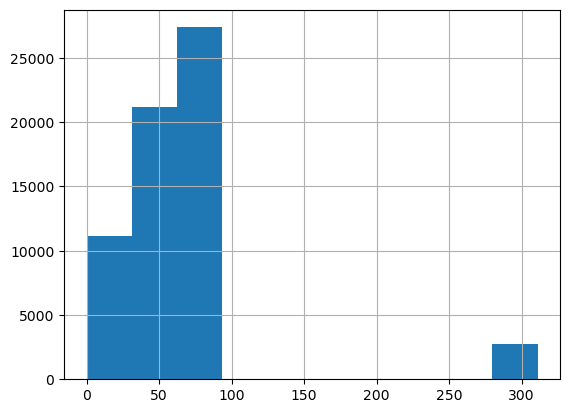

In [182]:
df['age'].hist()

3- Likewise, we can create a variable indicating hospital length of stay.


In [183]:
# subtract ADMITTIME from DISCHTIME and express difference in days 'D' df['LOS']

df['dischtime'] = pd.to_datetime(df['dischtime'])
df['admittime'] = pd.to_datetime(df['admittime'])
df['los'] = df.apply(lambda x: relativedelta(x['dischtime'], x['admittime']).days, axis=1)

<Axes: >

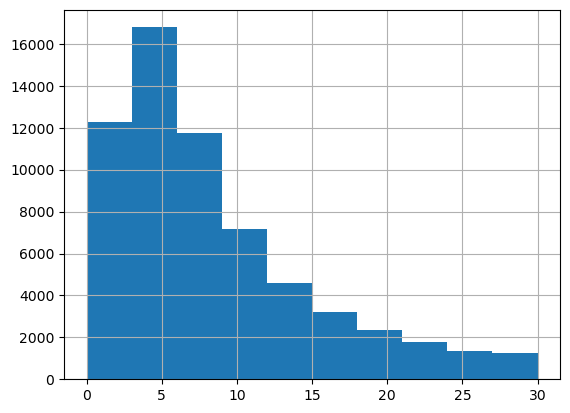

In [185]:
df['los'].hist()


4- We will also use SEPSIS as Our Prediction Target


<Axes: xlabel='sepsis'>

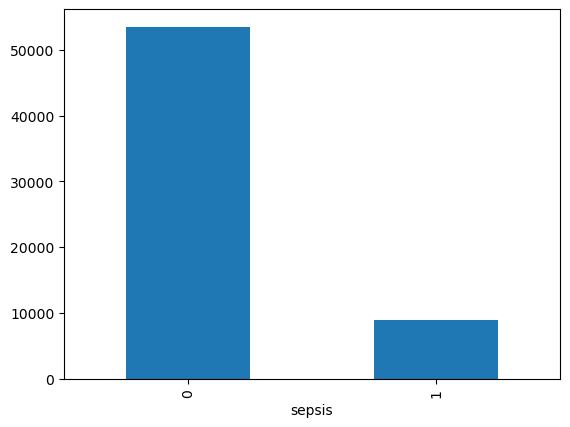

In [217]:
df['sepsis'].value_counts().plot.bar()

Check for Missing (NA)



In [188]:
df['sepsis'].isna().sum() 

0

#### Converting
The length of stay varies across patients, we may normalize the total count values into daily average count 
values in order to retrieve the frequency of the events. Here, I compute the values and save them as new columns,
and append '_DAY' to the original column names.

In [218]:
for col_name in ['diag_count', 'cpt_count', 'transfer_count', 'micro_count']: 
    df[col_name + '_day'] = df[col_name] /np.maximum(np.ceil(df['los']), 1)

In [219]:
df.head()

,subject_id,hadm_id,admission_type,admittime,dischtime,deathtime,IN_HOSP_DEATH,diagnosis,marital_status,insurance,language,religion,ethnicity,gender,dob,los_icu,callout_count,diag_count,pres_count,proc_count,cpt_count,lab_count,inputs_cv_count,inputs_mv_count,output_count,transfer_count,micro_count,sepsis,organ_failure,cardiovascular,renal,hepatic,hematologic,metabolic,neurologic,heartrate_min,heartrate_max,heartrate_mean,sysbp_min,heartrate_min-2,heartrate_max-2,heartrate_mean-2,sysbp_min-2,sysbp_max,sysbp_mean,diasbp_min,diasbp_max,diasbp_mean,meanbp_min,meanbp_max,meanbp_mean,resprate_min,resprate_max,resprate_mean,tempc_min,tempc_max,tempc_mean,spo2_min,spo2_max,spo2_mean,glucose_min,glucose_max,glucose_mean,age,los,diag_count_day,cpt_count_day,transfer_count_day,micro_count_day,gender_f,ethnicity_WHITE,ethnicity_BLACK/AFRICAN AMERICAN,ethnicity_UNKNOWN/NOT SPECIFIED,ethnicity_others
0,23804,100014,ELECTIVE,2111-03-05 03:42:00,2111-03-05 19:00:00,NaN,0,RIGHT SHOULDER ADHESIVE CAPSULITIS/SDA,SINGLE,Medicaid,ENGL,CATHOLIC,WHITE,F,2061-12-29,0.0000,NaN,8,NaN,3.0,2.0,NaN,NaN,NaN,NaN,3,0.0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,49,0,8.000000,2.000000,3.000000,0.000000,1,1,0,0,0
1,68591,100016,EMERGENCY,2188-05-24 13:06:00,2188-05-30 17:16:00,NaN,0,PNEUMONIA,SINGLE,Medicare,ENGL,PROTESTANT QUAKER,WHITE,M,2132-11-19,6.1731,NaN,11,62.0,5.0,15.0,212.0,NaN,160.0,102.0,3,5.0,0,1,0,0,0,0,0,0,79.0,103.0,91.120000,80.0,79.0,103.0,91.120000,80.0,136.0,104.956522,45.0,108.0,64.434783,57.0,111.0,73.521739,11.0,28.0,17.153846,35.500000,36.666667,36.077778,94.0,100.0,97.680000,76.0,76.0,76.000000,55,6,1.833333,2.500000,0.500000,0.833333,0,1,0,0,0
2,9973,100020,EMERGENCY,2142-11-30 01:53:00,2142-12-10 16:32:00,NaN,0,HYPONATREMIA,MARRIED,Private,ENGL,CATHOLIC,WHITE,M,2084-05-02,1.1011,1.0,18,55.0,NaN,18.0,341.0,NaN,15.0,19.0,5,7.0,0,1,0,1,0,0,0,1,49.0,80.0,62.333333,90.0,49.0,80.0,62.333333,90.0,225.0,135.250000,45.0,128.0,72.250000,56.0,151.0,87.000000,8.0,27.0,14.962963,35.166667,35.777778,35.416667,91.0,97.0,94.629630,79.0,101.0,90.000000,58,10,1.800000,1.800000,0.500000,0.700000,0,1,0,0,0
3,29971,100021,EMERGENCY,2109-08-17 10:55:00,2109-10-16 11:15:00,NaN,0,BILATERAL ANKLE FX; NEW AFLUTTER,MARRIED,Medicaid,SPAN,UNOBTAINABLE,HISPANIC OR LATINO,M,2054-10-24,3.6213,2.0,29,307.0,8.0,73.0,1392.0,143.0,NaN,42.0,7,47.0,0,1,0,0,1,1,0,1,84.0,134.0,105.533333,101.0,84.0,134.0,105.533333,101.0,162.0,130.900000,52.0,105.0,82.566667,69.0,113.0,93.600000,12.0,27.0,21.400000,36.777776,37.111113,36.953704,94.0,100.0,98.200000,142.0,155.0,146.333333,54,29,1.000000,2.517241,0.241379,1.620690,0,0,0,0,1
4,29971,100021,EMERGENCY,2109-08-17 10:55:00,2109-10-16 11:15:00,NaN,0,BILATERAL ANKLE FX; NEW AFLUTTER,MARRIED,Medicaid,SPAN,UNOBTAINABLE,HISPANIC OR LATINO,M,2054-10-24,3.6213,2.0,29,307.0,8.0,73.0,1392.0,143.0,NaN,42.0,7,47.0,0,1,0,0,1,1,0,1,71.0,120.0,100.772727,96.0,71.0,120.0,100.772727,96.0,155.0,126.727273,51.0,95.0,77.045455,61.0,101.0,88.454545,12.0,32.0,21.181818,36.388889,37.333332,36.874999,91.0,100.0,95.909091,105.0,159.0,121.800000,54,29,1.000000,2.517241,0.241379,1.620690,0,0,0,0,1


### Completing

###### Numerical features
Regarding the features related to counts and counts per day, we can simply fill all NaN values with 0.

In [220]:
for col_name in ['diag_count', 'cpt_count', 'transfer_count', 'micro_count']:
    df[col_name] = df[col_name].fillna(0) 

df[col_name + '_day'] = df[col_name + '_day'].fillna(0)

In [221]:
df['diag_count'] = df['diag_count'].fillna(0) 
df['los_icu'] = df['los_icu'].fillna(0)

In [197]:
df.head()

,subject_id,hadm_id,admission_type,admittime,dischtime,deathtime,IN_HOSP_DEATH,diagnosis,marital_status,insurance,language,religion,ethnicity,gender,dob,los_icu,callout_count,diag_count,pres_count,proc_count,cpt_count,lab_count,inputs_cv_count,inputs_mv_count,output_count,transfer_count,micro_count,sepsis,organ_failure,cardiovascular,renal,hepatic,hematologic,metabolic,neurologic,heartrate_min,heartrate_max,heartrate_mean,sysbp_min,heartrate_min-2,heartrate_max-2,heartrate_mean-2,sysbp_min-2,sysbp_max,sysbp_mean,diasbp_min,diasbp_max,diasbp_mean,meanbp_min,meanbp_max,meanbp_mean,resprate_min,resprate_max,resprate_mean,tempc_min,tempc_max,tempc_mean,spo2_min,spo2_max,spo2_mean,glucose_min,glucose_max,glucose_mean,age,los,diag_count_day,cpt_count_day,transfer_count_day,micro_count_day
0,23804,100014,ELECTIVE,2111-03-05 03:42:00,2111-03-05 19:00:00,NaN,0,RIGHT SHOULDER ADHESIVE CAPSULITIS/SDA,SINGLE,Medicaid,ENGL,CATHOLIC,WHITE,F,2061-12-29,0.0000,NaN,8,NaN,3.0,2.0,NaN,NaN,NaN,NaN,3,0.0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,49,0,8.000000,2.000000,3.000000,0.000000
1,68591,100016,EMERGENCY,2188-05-24 13:06:00,2188-05-30 17:16:00,NaN,0,PNEUMONIA,SINGLE,Medicare,ENGL,PROTESTANT QUAKER,WHITE,M,2132-11-19,6.1731,NaN,11,62.0,5.0,15.0,212.0,NaN,160.0,102.0,3,5.0,0,1,0,0,0,0,0,0,79.0,103.0,91.120000,80.0,79.0,103.0,91.120000,80.0,136.0,104.956522,45.0,108.0,64.434783,57.0,111.0,73.521739,11.0,28.0,17.153846,35.500000,36.666667,36.077778,94.0,100.0,97.680000,76.0,76.0,76.000000,55,6,1.833333,2.500000,0.500000,0.833333
2,9973,100020,EMERGENCY,2142-11-30 01:53:00,2142-12-10 16:32:00,NaN,0,HYPONATREMIA,MARRIED,Private,ENGL,CATHOLIC,WHITE,M,2084-05-02,1.1011,1.0,18,55.0,NaN,18.0,341.0,NaN,15.0,19.0,5,7.0,0,1,0,1,0,0,0,1,49.0,80.0,62.333333,90.0,49.0,80.0,62.333333,90.0,225.0,135.250000,45.0,128.0,72.250000,56.0,151.0,87.000000,8.0,27.0,14.962963,35.166667,35.777778,35.416667,91.0,97.0,94.629630,79.0,101.0,90.000000,58,10,1.800000,1.800000,0.500000,0.700000
3,29971,100021,EMERGENCY,2109-08-17 10:55:00,2109-10-16 11:15:00,NaN,0,BILATERAL ANKLE FX; NEW AFLUTTER,MARRIED,Medicaid,SPAN,UNOBTAINABLE,HISPANIC OR LATINO,M,2054-10-24,3.6213,2.0,29,307.0,8.0,73.0,1392.0,143.0,NaN,42.0,7,47.0,0,1,0,0,1,1,0,1,84.0,134.0,105.533333,101.0,84.0,134.0,105.533333,101.0,162.0,130.900000,52.0,105.0,82.566667,69.0,113.0,93.600000,12.0,27.0,21.400000,36.777776,37.111113,36.953704,94.0,100.0,98.200000,142.0,155.0,146.333333,54,29,1.000000,2.517241,0.241379,1.620690
4,29971,100021,EMERGENCY,2109-08-17 10:55:00,2109-10-16 11:15:00,NaN,0,BILATERAL ANKLE FX; NEW AFLUTTER,MARRIED,Medicaid,SPAN,UNOBTAINABLE,HISPANIC OR LATINO,M,2054-10-24,3.6213,2.0,29,307.0,8.0,73.0,1392.0,143.0,NaN,42.0,7,47.0,0,1,0,0,1,1,0,1,71.0,120.0,100.772727,96.0,71.0,120.0,100.772727,96.0,155.0,126.727273,51.0,95.0,77.045455,61.0,101.0,88.454545,12.0,32.0,21.181818,36.388889,37.333332,36.874999,91.0,100.0,95.909091,105.0,159.0,121.800000,54,29,1.000000,2.517241,0.241379,1.620690


In [198]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62477 entries, 0 to 62476
Data columns (total 69 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   subject_id          62477 non-null  int64         
 1   hadm_id             62477 non-null  int64         
 2   admission_type      62477 non-null  object        
 3   admittime           62477 non-null  datetime64[ns]
 4   dischtime           62477 non-null  datetime64[ns]
 5   deathtime           6624 non-null   object        
 6   IN_HOSP_DEATH       62477 non-null  int64         
 7   diagnosis           62452 non-null  object        
 8   marital_status      52155 non-null  object        
 9   insurance           62477 non-null  object        
 10  language            35933 non-null  object        
 11  religion            61995 non-null  object        
 12  ethnicity           62477 non-null  object        
 13  gender              62477 non-null  object    

##### Handling missing Values by filling it with the mean

In [ ]:

df['heartrate_mean'] = df['heartrate_mean'].fillna(df['heartrate_mean'].mean()) 
df['sysbp_mean'] = df['sysbp_mean'].fillna(df['sysbp_mean'].mean()) 
df['diasbp_mean'] = df['diasbp_mean'].fillna(df['diasbp_mean'].mean()) 
df['meanbp_mean'] = df['meanbp_mean'].fillna(df['meanbp_mean'].mean()) 
df['resprate_mean'] = df['resprate_mean'].fillna(df['resprate_mean'].mean()) 
df['tempc_mean'] = df['tempc_mean'].fillna(df['tempc_mean'].mean()) 
df['spo2_mean'] = df['spo2_mean'].fillna(df['spo2_mean'].mean())
df['glucose_mean'] = df['glucose_mean'].fillna(df['glucose_mean'].mean())

In [13]:
df['IN_HOSP_DEATH'].value_counts()

IN_HOSP_DEATH
0    55853
1     6624
Name: count, dtype: int64

In [145]:
df['sepsis'].value_counts()

sepsis
0    45255
1     8953
Name: count, dtype: int64

In [15]:
df['age']

0         49
1         55
2         58
3         54
4         54
        ... 
62472     78
62473    300
62474     73
62475     23
62476     88
Name: age, Length: 62477, dtype: int64

<Axes: >

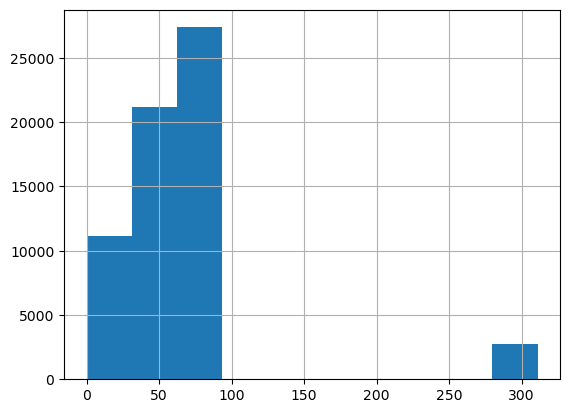

In [16]:
df['age'].hist()

In [18]:
df['los']

0         0
1         6
2        10
3        29
4        29
         ..
62472    13
62473     3
62474     2
62475    16
62476     5
Name: los, Length: 62477, dtype: int64

In [19]:
df['los'].describe()


count    62477.000000
mean         7.961842
std          6.634894
min          0.000000
25%          3.000000
50%          6.000000
75%         11.000000
max         30.000000
Name: los, dtype: float64

<Axes: >

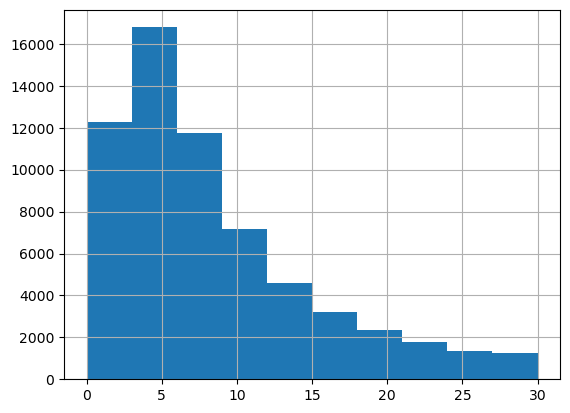

In [20]:
df['los'].hist()

In [21]:
df.loc[df['age'] >= 18, 'adult'] = 1

## Completing
##### Numerical features
###### Regarding the features related to counts and counts per day, we can simply fill all NaN values with 0.

In [28]:
df['diag_count'] = df['diag_count'].fillna(0) 
df['los_icu'] = df['los_icu'].fillna(0)


In [29]:
df.head()

,subject_id,hadm_id,admission_type,admittime,dischtime,deathtime,IN_HOSP_DEATH,diagnosis,marital_status,insurance,...,glucose_min,glucose_max,glucose_mean,age,los,adult,diag_count_day,cpt_count_day,transfer_count_day,micro_count_day
0,23804,100014,ELECTIVE,2111-03-05 03:42:00,2111-03-05 19:00:00,NaN,0,RIGHT SHOULDER ADHESIVE CAPSULITIS/SDA,SINGLE,Medicaid,...,NaN,NaN,NaN,49,0,1.0,8.000000,2.000000,3.000000,0.000000
1,68591,100016,EMERGENCY,2188-05-24 13:06:00,2188-05-30 17:16:00,NaN,0,PNEUMONIA,SINGLE,Medicare,...,76.0,76.0,76.000000,55,6,1.0,1.833333,2.500000,0.500000,0.833333
2,9973,100020,EMERGENCY,2142-11-30 01:53:00,2142-12-10 16:32:00,NaN,0,HYPONATREMIA,MARRIED,Private,...,79.0,101.0,90.000000,58,10,1.0,1.800000,1.800000,0.500000,0.700000
3,29971,100021,EMERGENCY,2109-08-17 10:55:00,2109-10-16 11:15:00,NaN,0,BILATERAL ANKLE FX; NEW AFLUTTER,MARRIED,Medicaid,...,142.0,155.0,146.333333,54,29,1.0,1.000000,2.517241,0.241379,1.620690
4,29971,100021,EMERGENCY,2109-08-17 10:55:00,2109-10-16 11:15:00,NaN,0,BILATERAL ANKLE FX; NEW AFLUTTER,MARRIED,Medicaid,...,105.0,159.0,121.800000,54,29,1.0,1.000000,2.517241,0.241379,1.620690


In [30]:
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62477 entries, 0 to 62476
Data columns (total 70 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   subject_id          62477 non-null  int64         
 1   hadm_id             62477 non-null  int64         
 2   admission_type      62477 non-null  object        
 3   admittime           62477 non-null  datetime64[ns]
 4   dischtime           62477 non-null  datetime64[ns]
 5   deathtime           6624 non-null   object        
 6   IN_HOSP_DEATH       62477 non-null  int64         
 7   diagnosis           62452 non-null  object        
 8   marital_status      52155 non-null  object        
 9   insurance           62477 non-null  object        
 10  language            35933 non-null  object        
 11  religion            61995 non-null  object        
 12  ethnicity           62477 non-null  object        
 13  gender              62477 non-null  object    

In [31]:
df['heartrate_mean'].mean()


91.70463753354971

In [33]:
df.columns

Index(['subject_id', 'hadm_id', 'admission_type', 'admittime', 'dischtime',
       'deathtime', 'IN_HOSP_DEATH', 'diagnosis', 'marital_status',
       'insurance', 'language', 'religion', 'ethnicity', 'gender', 'dob',
       'los_icu', 'callout_count', 'diag_count', 'pres_count', 'proc_count',
       'cpt_count', 'lab_count', 'inputs_cv_count', 'inputs_mv_count',
       'output_count', 'transfer_count', 'micro_count', 'sepsis',
       'organ_failure', 'cardiovascular', 'renal', 'hepatic', 'hematologic',
       'metabolic', 'neurologic', 'heartrate_min', 'heartrate_max',
       'heartrate_mean', 'sysbp_min', 'heartrate_min-2', 'heartrate_max-2',
       'heartrate_mean-2', 'sysbp_min-2', 'sysbp_max', 'sysbp_mean',
       'diasbp_min', 'diasbp_max', 'diasbp_mean', 'meanbp_min', 'meanbp_max',
       'meanbp_mean', 'resprate_min', 'resprate_max', 'resprate_mean',
       'tempc_min', 'tempc_max', 'tempc_mean', 'spo2_min', 'spo2_max',
       'spo2_mean', 'glucose_min', 'glucose_max', 'glucose

#### Categorical features
There are three categorical variables containing missing values.

MARITAL_STATUS: fill in the default value

In [34]:
df.info

<bound method DataFrame.info of        subject_id  hadm_id admission_type           admittime  \
0           23804   100014       ELECTIVE 2111-03-05 03:42:00   
1           68591   100016      EMERGENCY 2188-05-24 13:06:00   
2            9973   100020      EMERGENCY 2142-11-30 01:53:00   
3           29971   100021      EMERGENCY 2109-08-17 10:55:00   
4           29971   100021      EMERGENCY 2109-08-17 10:55:00   
...           ...      ...            ...                 ...   
62472       81561   199972       ELECTIVE 2186-08-29 07:15:00   
62473       28616   199981      EMERGENCY 2110-09-24 15:32:00   
62474        5887   199986      EMERGENCY 2188-10-30 16:55:00   
62475       19412   199995      EMERGENCY 2137-12-11 17:35:00   
62476       40370   199999      EMERGENCY 2136-04-04 23:37:00   

                dischtime deathtime  IN_HOSP_DEATH  \
0     2111-03-05 19:00:00       NaN              0   
1     2188-05-30 17:16:00       NaN              0   
2     2142-12-10 16:32:00

#### Correcting
As we have seen previously, the age column contains certain suspicious values. Why is that?

<Axes: >

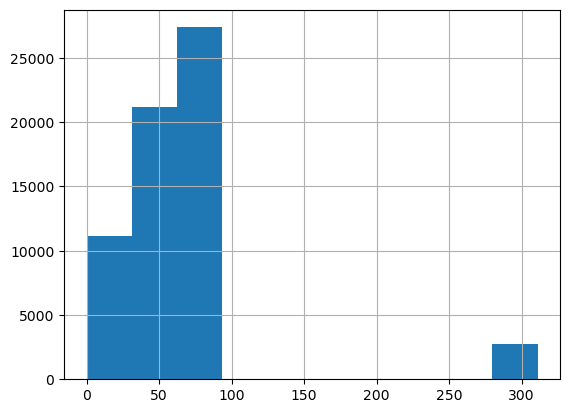

In [199]:
df['age'].hist()

<Axes: xlabel='age', ylabel='Count'>

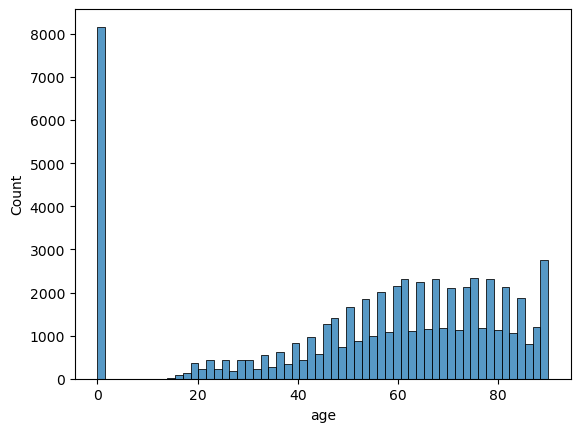

In [222]:
df.loc[df['age'] > 90, 'age'] = 90
sns.histplot(x = 'age', data = df)

In [226]:
df = df[df['age'] >= 18]
df.shape

(54208, 74)

The objective is to preserve values that, although extreme, are indicative of severe health states, while excluding values that are either implausible (like negative temperatures) or probable outliers (such as a heart rate surpassing 250 beats per minute). 
This approach allows us to eliminate data points that fall outside these predefined limits, thus removing highly unlikely outliers but keeping those extreme values that are still within the realm of possibility.

In [227]:
nulls_before = df.isnull().sum().sum()

In [228]:
variables = ['heartrate_mean', 'sysbp_mean', 'diasbp_mean','meanbp_mean', 'resprate_mean', 'tempc_mean', 'spo2_mean', 'glucose_mean']

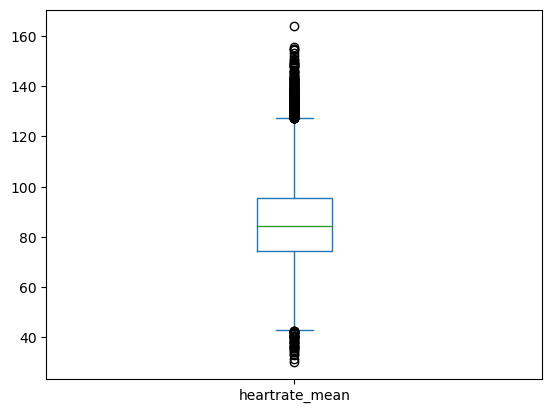

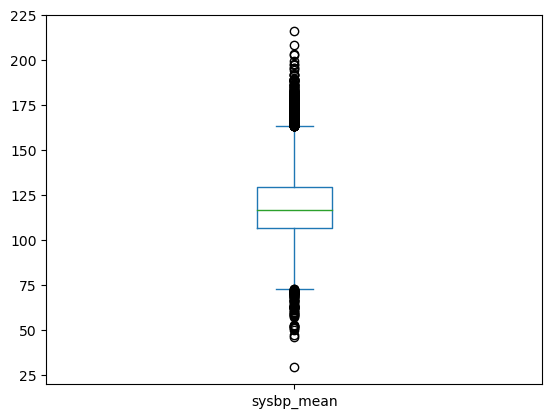

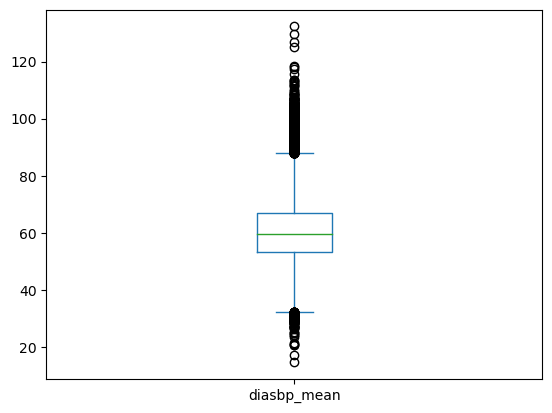

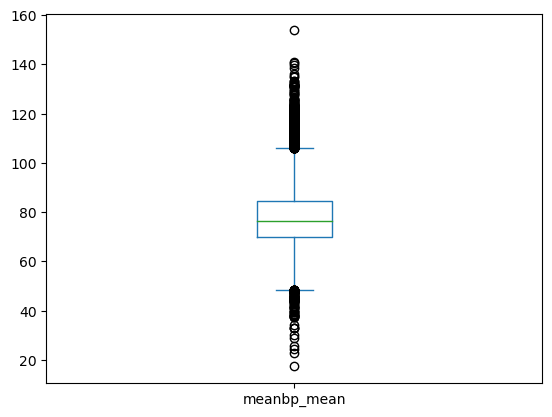

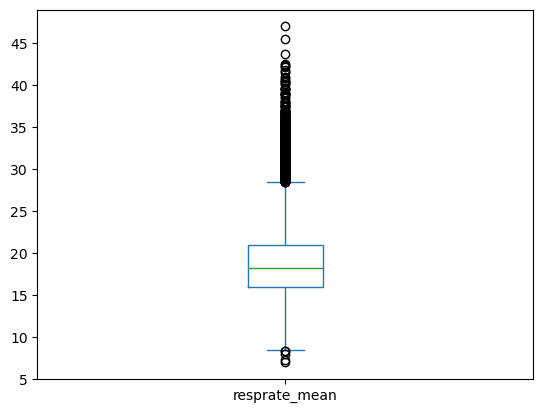

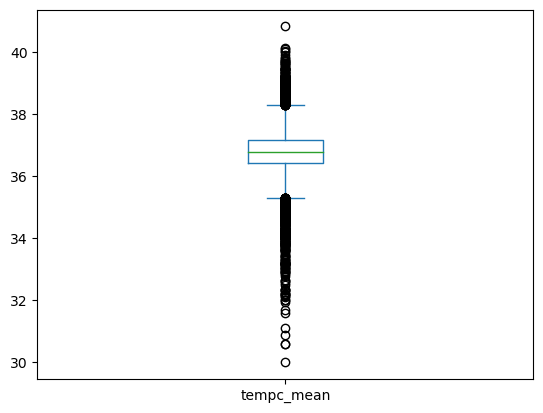

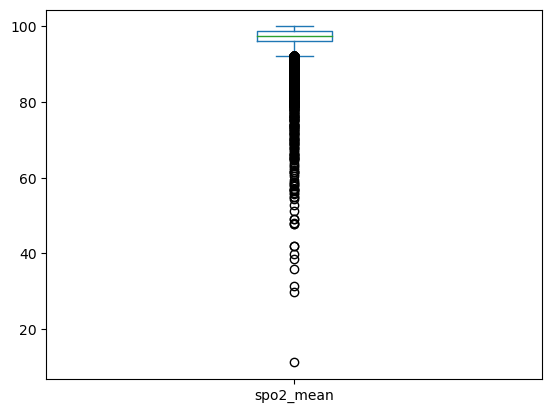

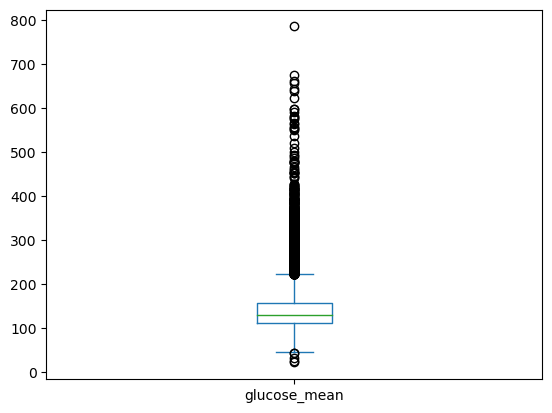

In [229]:
for variable in df[variables]:
    df[variable].plot.box()
    plt.xticks(ticks=[1], labels=[variable])  
    plt.show()


In [231]:
# nulls_before = df.isnull().sum().sum()

# Replace outliers with NaN in column names
df.loc[df['diasbp_mean'] > 300, 'diasbp_mean'] = np.nan
df.loc[df['glucose_mean'] > 2000, 'glucose_mean'] = np.nan
df.loc[df['heartrate_mean'] > 400, 'heartrate_mean'] = np.nan
df.loc[df['meanbp_mean'] > 300, 'meanbp_mean'] = np.nan
df.loc[df['meanbp_mean'] < 0, 'meanbp_mean'] = np.nan
df.loc[df['sysbp_mean'] > 10000, 'sysbp_mean'] = np.nan
df.loc[df['tempc_mean'] > 50, 'tempc_mean'] = np.nan
df.loc[df['tempc_mean'] < 20, 'tempc_mean'] = np.nan
df.loc[df['resprate_mean'] > 300, 'resprate_mean'] = np.nan
df.loc[df['spo2_mean'] > 100, 'spo2_mean'] = np.nan
df.loc[df['spo2_mean'] < 0, 'spo2_mean'] = np.nan

nulls_now = df.isnull().sum().sum()

print('Number of outliers removed: ' + str(nulls_now - nulls_before))


Number of outliers removed: 0


In [43]:
df.head()

,subject_id,hadm_id,admission_type,admittime,dischtime,deathtime,IN_HOSP_DEATH,diagnosis,marital_status,insurance,...,glucose_min,glucose_max,glucose_mean,age,los,adult,diag_count_day,cpt_count_day,transfer_count_day,micro_count_day
0,23804,100014,ELECTIVE,2111-03-05 03:42:00,2111-03-05 19:00:00,NaN,0,RIGHT SHOULDER ADHESIVE CAPSULITIS/SDA,SINGLE,Medicaid,...,NaN,NaN,139.714471,49,0,1.0,8.000000,2.000000,3.000000,0.000000
1,68591,100016,EMERGENCY,2188-05-24 13:06:00,2188-05-30 17:16:00,NaN,0,PNEUMONIA,SINGLE,Medicare,...,76.0,76.0,76.000000,55,6,1.0,1.833333,2.500000,0.500000,0.833333
2,9973,100020,EMERGENCY,2142-11-30 01:53:00,2142-12-10 16:32:00,NaN,0,HYPONATREMIA,MARRIED,Private,...,79.0,101.0,90.000000,58,10,1.0,1.800000,1.800000,0.500000,0.700000
3,29971,100021,EMERGENCY,2109-08-17 10:55:00,2109-10-16 11:15:00,NaN,0,BILATERAL ANKLE FX; NEW AFLUTTER,MARRIED,Medicaid,...,142.0,155.0,146.333333,54,29,1.0,1.000000,2.517241,0.241379,1.620690
4,29971,100021,EMERGENCY,2109-08-17 10:55:00,2109-10-16 11:15:00,NaN,0,BILATERAL ANKLE FX; NEW AFLUTTER,MARRIED,Medicaid,...,105.0,159.0,121.800000,54,29,1.0,1.000000,2.517241,0.241379,1.620690


###### A number of measures were performed to protect patient privacy. Quoting from MIMIC-III's documentation,
  - All dates in the database have been shifted to protect patient confidentiality. Dates will be internally consistent for the same patient, but randomly distributed in the future.
   - Dates of birth which occur in the present time are not true dates of birth. Furthermore, dates of birth which occur before the year 1900 occur if the patient is older than 89. In these cases, the patient’s age at their first admission has been fixed to 300.

- In other words, all patients with a negative 'age' calculated above are older than 89. For illustration, let's simply set them to be 90.



In [203]:
df.loc[df['age'] >=90, 'age'] = 90


#### Encoding for Categorical Variables (Converting)
###### admission_type

In [204]:
tmp_df_admissions = pd.get_dummies(df['admission_type'], prefix='admission_type').astype(int)
tmp_df_admissions.head()

,admission_type_ELECTIVE,admission_type_EMERGENCY,admission_type_NEWBORN,admission_type_URGENT
0,1,0,0,0
1,0,1,0,0
2,0,1,0,0
3,0,1,0,0
4,0,1,0,0


In [46]:
# add the above temporary dataframe to the original dataframe, axis = 1 specifies that we want 
#to stack them horizontally not vertically
df = pd.concat([df, tmp_df_admissions], axis = 1) 

In [205]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62477 entries, 0 to 62476
Data columns (total 69 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   subject_id          62477 non-null  int64         
 1   hadm_id             62477 non-null  int64         
 2   admission_type      62477 non-null  object        
 3   admittime           62477 non-null  datetime64[ns]
 4   dischtime           62477 non-null  datetime64[ns]
 5   deathtime           6624 non-null   object        
 6   IN_HOSP_DEATH       62477 non-null  int64         
 7   diagnosis           62452 non-null  object        
 8   marital_status      52155 non-null  object        
 9   insurance           62477 non-null  object        
 10  language            35933 non-null  object        
 11  religion            61995 non-null  object        
 12  ethnicity           62477 non-null  object        
 13  gender              62477 non-null  object    

##### gender

As the column only takes on two values 'M' and 'F', it is easier to simply do a logical operation and save the results as a new column.

In [206]:
df['gender'].value_counts()

gender
M    34986
F    27491
Name: count, dtype: int64

In [207]:
df['gender_f'] = (df['gender'] == 'F') * 1


In [208]:
df['gender_f'].value_counts()

gender_f
0    34986
1    27491
Name: count, dtype: int64

In [209]:
tmp_categories = list(df['ethnicity'].value_counts()[:3].keys()) + ['others']  # retain the top 3 categories, plus 'others'
tmp_categories_dtype = pd.CategoricalDtype(tmp_categories)
tmp_df = df['ethnicity'].astype(tmp_categories_dtype).fillna('others')
tmp_df = pd.get_dummies(tmp_df, prefix='ethnicity').astype(int)  # create a temporary dataframe with the modified categories
df = pd.concat([df, tmp_df], axis=1)  # add to original dataframe
tmp_df

,ethnicity_WHITE,ethnicity_BLACK/AFRICAN AMERICAN,ethnicity_UNKNOWN/NOT SPECIFIED,ethnicity_others
0,1,0,0,0
1,1,0,0,0
2,1,0,0,0
3,0,0,0,1
4,0,0,0,1
5,1,0,0,0
6,0,0,1,0
7,1,0,0,0
8,1,0,0,0
9,1,0,0,0


In [210]:
dfall = df

In [ ]:
dfall

In [56]:
# Convert non-numeric columns to numeric if possible
df_numeric = df.apply(pd.to_numeric, errors='coerce')

# Compute correlation matrix
pearsoncorr = df_numeric.corr(method='pearson')
pearsoncorr

,subject_id,hadm_id,admission_type,admittime,dischtime,deathtime,IN_HOSP_DEATH,diagnosis,marital_status,insurance,...,micro_count_day,admission_type_ELECTIVE,admission_type_EMERGENCY,admission_type_NEWBORN,admission_type_URGENT,gender_f,ethnicity_WHITE,ethnicity_BLACK/AFRICAN AMERICAN,ethnicity_UNKNOWN/NOT SPECIFIED,ethnicity_others
subject_id,1.000000,0.006910,NaN,0.001261,0.001187,NaN,-0.028411,1.0,NaN,NaN,...,-0.021274,0.009480,0.021138,NaN,-0.071701,0.000389,0.022602,-0.020143,-0.141690,0.103743
hadm_id,0.006910,1.000000,NaN,0.002831,0.002828,NaN,-0.000859,1.0,NaN,NaN,...,0.000245,-0.001297,0.001697,NaN,-0.001150,-0.003137,0.005182,0.001047,0.004214,-0.011625
admission_type,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
admittime,0.001261,0.002831,NaN,1.000000,0.999999,NaN,-0.003222,-1.0,NaN,NaN,...,0.002141,0.000238,0.005788,NaN,-0.014356,-0.006644,0.000186,0.010529,-0.004821,-0.005466
dischtime,0.001187,0.002828,NaN,0.999999,1.000000,NaN,-0.003167,-1.0,NaN,NaN,...,0.002553,0.000193,0.005812,NaN,-0.014312,-0.006658,0.000195,0.010520,-0.004813,-0.005476
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
gender_f,0.000389,-0.003137,NaN,-0.006644,-0.006658,NaN,0.012931,NaN,NaN,NaN,...,0.002195,-0.022374,0.019568,NaN,0.003346,1.000000,-0.024263,0.081192,-0.020361,-0.020331
ethnicity_WHITE,0.022602,0.005182,NaN,0.000186,0.000195,NaN,-0.012358,-1.0,NaN,NaN,...,0.001283,0.054522,-0.024007,NaN,-0.064698,-0.024263,1.000000,-0.490394,-0.460505,-0.580911
ethnicity_BLACK/AFRICAN AMERICAN,-0.020143,0.001047,NaN,0.010529,0.010520,NaN,-0.027217,1.0,NaN,NaN,...,0.006881,-0.066962,0.076807,NaN,-0.033555,0.081192,-0.490394,1.000000,-0.091751,-0.115740
ethnicity_UNKNOWN/NOT SPECIFIED,-0.141690,0.004214,NaN,-0.004821,-0.004813,NaN,0.060219,NaN,NaN,NaN,...,-0.003576,-0.018374,-0.048211,NaN,0.156262,-0.020361,-0.460505,-0.091751,1.000000,-0.108686


#### Correlating

In [57]:
dfvitals = df[['sepsis', 'heartrate_mean', 'sysbp_mean', 'diasbp_mean', 'meanbp_mean', 'resprate_mean', 'tempc_mean', 'spo2_mean', 'glucose_mean']]

In [58]:
vitalscorr = dfvitals.corr(method ='pearson')


<Axes: >

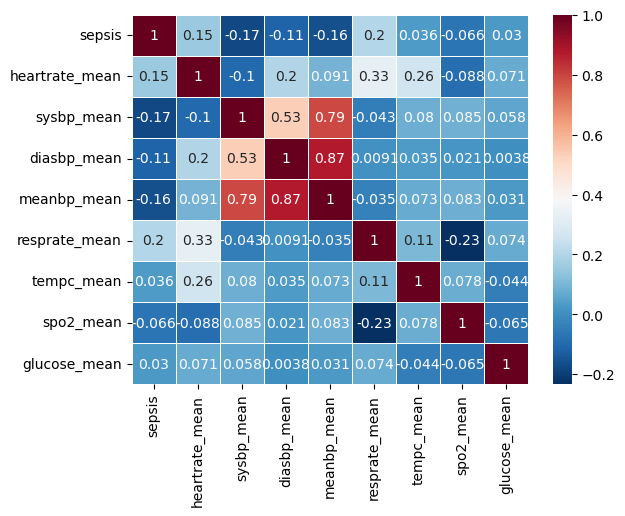

In [59]:
sns.heatmap(vitalscorr, xticklabels=vitalscorr.columns, yticklabels=vitalscorr.columns, cmap='RdBu_r', annot=True, linewidth=0.5)

In [60]:
dfdiag = df[['sepsis', 'organ_failure', 'cardiovascular', 'renal', 'hepatic', 'hematologic', 'metabolic', 'neurologic']]
dflos = df[['sepsis', 'los', 'los_icu']]


In [61]:
corrLOS = dflos.corr(method ='pearson') 
corrdfdiag = dfdiag.corr(method ='pearson')


<Axes: >

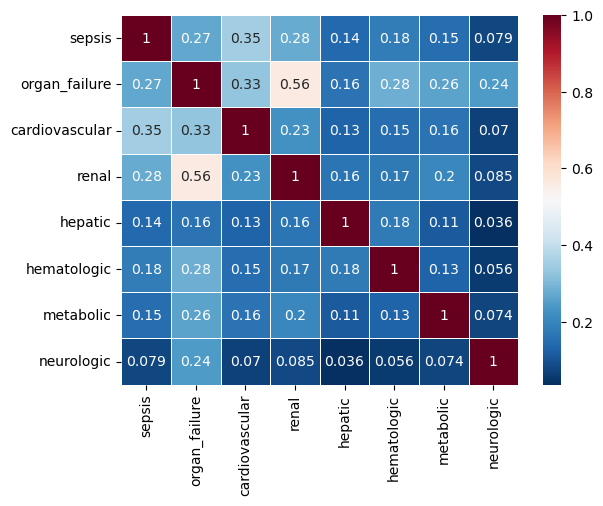

In [62]:
sns.heatmap(corrdfdiag, xticklabels=corrdfdiag.columns, yticklabels=corrdfdiag.columns, cmap='RdBu_r', annot=True, linewidth=0.5)


<Axes: >

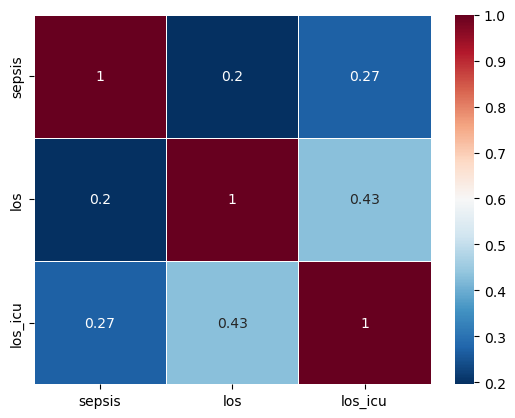

In [63]:
sns.heatmap(corrLOS, xticklabels=corrLOS.columns, yticklabels=corrLOS.columns, cmap='RdBu_r', annot=True, linewidth=0.5)


### Cohort Selection
Filter 18 years and Above



In [64]:
df = df[df.adult == 1]
df.head()

,subject_id,hadm_id,admission_type,admittime,dischtime,deathtime,IN_HOSP_DEATH,diagnosis,marital_status,insurance,...,micro_count_day,admission_type_ELECTIVE,admission_type_EMERGENCY,admission_type_NEWBORN,admission_type_URGENT,gender_f,ethnicity_WHITE,ethnicity_BLACK/AFRICAN AMERICAN,ethnicity_UNKNOWN/NOT SPECIFIED,ethnicity_others
0,23804,100014,ELECTIVE,2111-03-05 03:42:00,2111-03-05 19:00:00,NaN,0,RIGHT SHOULDER ADHESIVE CAPSULITIS/SDA,SINGLE,Medicaid,...,0.000000,1,0,0,0,1,1,0,0,0
1,68591,100016,EMERGENCY,2188-05-24 13:06:00,2188-05-30 17:16:00,NaN,0,PNEUMONIA,SINGLE,Medicare,...,0.833333,0,1,0,0,0,1,0,0,0
2,9973,100020,EMERGENCY,2142-11-30 01:53:00,2142-12-10 16:32:00,NaN,0,HYPONATREMIA,MARRIED,Private,...,0.700000,0,1,0,0,0,1,0,0,0
3,29971,100021,EMERGENCY,2109-08-17 10:55:00,2109-10-16 11:15:00,NaN,0,BILATERAL ANKLE FX; NEW AFLUTTER,MARRIED,Medicaid,...,1.620690,0,1,0,0,0,0,0,0,1
4,29971,100021,EMERGENCY,2109-08-17 10:55:00,2109-10-16 11:15:00,NaN,0,BILATERAL ANKLE FX; NEW AFLUTTER,MARRIED,Medicaid,...,1.620690,0,1,0,0,0,0,0,0,1


In [65]:
df.shape

(54208, 79)

### Save the pre-processed dataframe
First let's check the pre-processed dataframe.

In [213]:
df.to_csv('mimic_sepsis_clean.csv', index = False)

In [ ]:
pd.read_csv('mimic_sepsis_clean.csv') 

In [68]:
df.columns

Index(['subject_id', 'hadm_id', 'admission_type', 'admittime', 'dischtime',
       'deathtime', 'IN_HOSP_DEATH', 'diagnosis', 'marital_status',
       'insurance', 'language', 'religion', 'ethnicity', 'gender', 'dob',
       'los_icu', 'callout_count', 'diag_count', 'pres_count', 'proc_count',
       'cpt_count', 'lab_count', 'inputs_cv_count', 'inputs_mv_count',
       'output_count', 'transfer_count', 'micro_count', 'sepsis',
       'organ_failure', 'cardiovascular', 'renal', 'hepatic', 'hematologic',
       'metabolic', 'neurologic', 'heartrate_min', 'heartrate_max',
       'heartrate_mean', 'sysbp_min', 'heartrate_min-2', 'heartrate_max-2',
       'heartrate_mean-2', 'sysbp_min-2', 'sysbp_max', 'sysbp_mean',
       'diasbp_min', 'diasbp_max', 'diasbp_mean', 'meanbp_min', 'meanbp_max',
       'meanbp_mean', 'resprate_min', 'resprate_max', 'resprate_mean',
       'tempc_min', 'tempc_max', 'tempc_mean', 'spo2_min', 'spo2_max',
       'spo2_mean', 'glucose_min', 'glucose_max', 'glucose

In [69]:
dfAll.columns


Index(['subject_id', 'hadm_id', 'admission_type', 'admittime', 'dischtime',
       'deathtime', 'hospital_expire_flag', 'diagnosis', 'marital_status',
       'insurance', 'language', 'religion', 'ethnicity', 'gender', 'dob',
       'los_icu', 'callout_count', 'diag_count', 'pres_count', 'proc_count',
       'cpt_count', 'lab_count', 'inputs_cv_count', 'inputs_mv_count',
       'output_count', 'transfer_count', 'micro_count', 'sepsis',
       'organ_failure', 'cardiovascular', 'renal', 'hepatic', 'hematologic',
       'metabolic', 'neurologic', 'heartrate_min', 'heartrate_max',
       'heartrate_mean', 'sysbp_min', 'heartrate_min-2', 'heartrate_max-2',
       'heartrate_mean-2', 'sysbp_min-2', 'sysbp_max', 'sysbp_mean',
       'diasbp_min', 'diasbp_max', 'diasbp_mean', 'meanbp_min', 'meanbp_max',
       'meanbp_mean', 'resprate_min', 'resprate_max', 'resprate_mean',
       'tempc_min', 'tempc_max', 'tempc_mean', 'spo2_min', 'spo2_max',
       'spo2_mean', 'glucose_min', 'glucose_max', '

In [70]:
dfAll["hadm_id"].count()


62477

### Exploratory data analysis

###### Prediction Target: SEPSIS


In [71]:
df['sepsis'].value_counts()


sepsis
0    45255
1     8953
Name: count, dtype: int64

In [72]:
8953 / (45255 + 8953) * 100

16.516012396694215

The overall Rate at which patient get SEPSIS is 8953 / (45255 + 8953) * 100 = 16.52%

###### Prediction Target: IN_HOSP_DEATH

In [73]:
df['IN_HOSP_DEATH'].value_counts()


IN_HOSP_DEATH
0    47659
1     6549
Name: count, dtype: int64

In [74]:
6549 / (6549 + 47659) * 100

12.081242621015347

The overall in-hospital death rate is 6549 / (6549 + 47659) * 100=12.08%

###  Categorical features
We can calculate and visualize each feature by group. 
For simple visualizations in Python, the package seaborn may come in handy.

GENDER

The average in-hospital mortality rate for each gender

In [212]:
df[['gender', 'IN_HOSP_DEATH']].groupby(['gender']).mean()

,IN_HOSP_DEATH
gender,
F,0.109199
M,0.103527


In [77]:
df[['gender', 'sepsis']].groupby(['gender']).mean()


,sepsis
gender,
F,0.163465
M,0.166476


<Axes: xlabel='gender', ylabel='IN_HOSP_DEATH'>

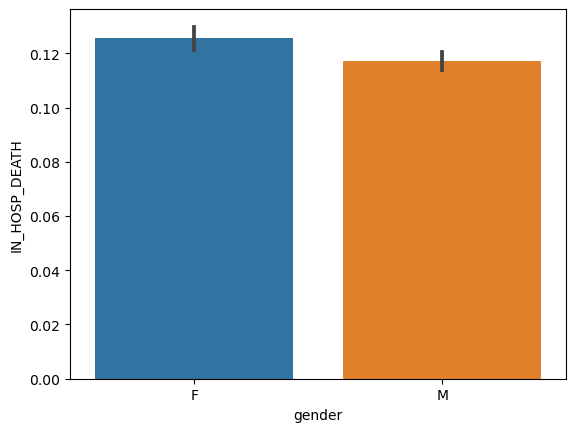

In [78]:
sns.barplot(x = 'gender', y = 'IN_HOSP_DEATH', data = df)


<Axes: xlabel='gender', ylabel='sepsis'>

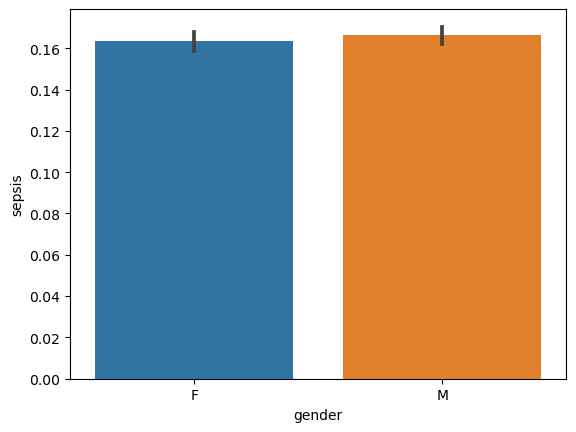

In [79]:
sns.barplot(x = 'gender', y = 'sepsis', data = df)


##### ADMISSION_TYPE

In [80]:
df[['admission_type', 'IN_HOSP_DEATH']].groupby(['admission_type']).mean()


,IN_HOSP_DEATH
admission_type,
ELECTIVE,0.031440
EMERGENCY,0.136695
URGENT,0.129170


In [81]:
df[['admission_type', 'sepsis']].groupby(['admission_type']).mean()


,sepsis
admission_type,
ELECTIVE,0.045303
EMERGENCY,0.186807
URGENT,0.165366


<Axes: xlabel='admission_type', ylabel='IN_HOSP_DEATH'>

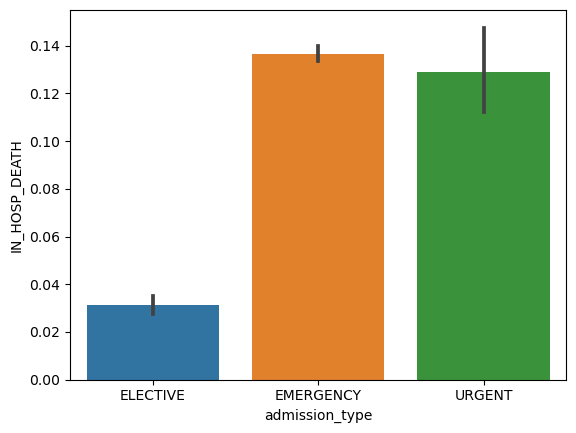

In [82]:
sns.barplot(x = 'admission_type', y = 'IN_HOSP_DEATH', data = df)


<Axes: xlabel='admission_type', ylabel='sepsis'>

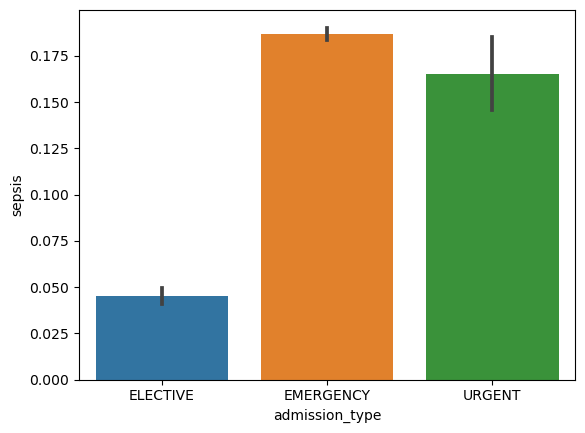

In [83]:
sns.barplot(x = 'admission_type', y = 'sepsis', data = df)


In [94]:
df.describe()


,subject_id,hadm_id,admittime,dischtime,IN_HOSP_DEATH,dob,los_icu,callout_count,diag_count,pres_count,...,micro_count_day,admission_type_ELECTIVE,admission_type_EMERGENCY,admission_type_NEWBORN,admission_type_URGENT,gender_f,ethnicity_WHITE,ethnicity_BLACK/AFRICAN AMERICAN,ethnicity_UNKNOWN/NOT SPECIFIED,ethnicity_others
count,54208.000000,54208.000000,54208,54208,54208.000000,54208,54208.000000,31207.000000,54208.000000,49640.000000,...,54208.000000,54208.000000,54208.000000,54208.0,54208.000000,54208.000000,54208.000000,54208.000000,54208.000000,54208.000000
mean,36617.271786,149985.074731,2151-05-01 07:56:29.424439296,2151-05-12 10:39:09.538813952,0.120812,2076-08-16 19:16:38.288075264,4.860773,1.289935,12.234320,96.751853,...,2.254944,0.149037,0.824970,0.0,0.025992,0.436965,0.711094,0.089009,0.079324,0.120573
min,3.000000,100001.000000,2100-06-07 19:59:00,2100-06-09 17:09:00,0.000000,1800-07-02 00:00:00,0.000000,1.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,13183.000000,124888.500000,2126-04-10 04:33:44.999999488,2126-04-17 18:54:15.000000512,0.000000,2057-12-01 00:00:00,1.233100,1.000000,8.000000,42.000000,...,0.235294,0.000000,1.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,26523.000000,150047.000000,2151-02-03 13:17:30,2151-02-23 02:08:00,0.000000,2086-02-08 00:00:00,2.312950,1.000000,10.000000,73.000000,...,0.785714,0.000000,1.000000,0.0,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000
75%,59875.000000,175048.500000,2176-08-31 02:30:15.000000512,2176-09-07 14:10:00,0.000000,2112-03-30 00:00:00,4.999500,1.000000,16.000000,119.000000,...,2.000000,0.000000,1.000000,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000
max,99999.000000,199999.000000,2210-08-17 17:13:00,2210-08-24 19:43:00,1.000000,2183-07-09 00:00:00,260.708900,7.000000,39.000000,1400.000000,...,493.000000,1.000000,1.000000,0.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
std,28986.643624,28928.097561,NaN,NaN,0.325912,NaN,7.570722,0.654425,6.715598,90.035579,...,7.626627,0.356128,0.379996,0.0,0.159114,0.496015,0.453258,0.284759,0.270246,0.325633


###### Numerical features



<Axes: xlabel='age'>

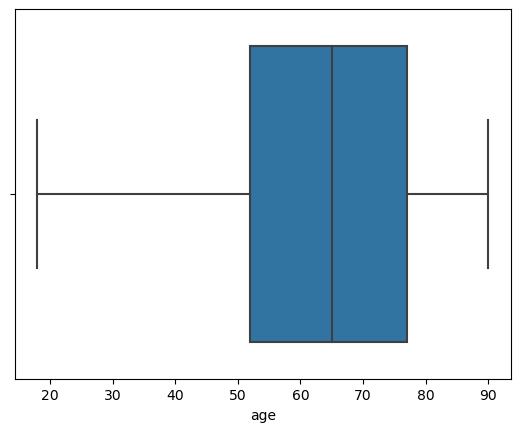

In [86]:
sns.boxplot(x = 'age', data = df)


C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


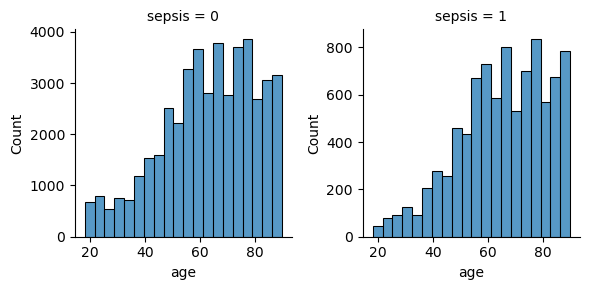

In [87]:
g = sns.FacetGrid(df, col = 'sepsis', sharey = False) 
g.map(sns.histplot, 'age', bins = 20)


In [88]:
df.columns


Index(['subject_id', 'hadm_id', 'admission_type', 'admittime', 'dischtime',
       'deathtime', 'IN_HOSP_DEATH', 'diagnosis', 'marital_status',
       'insurance', 'language', 'religion', 'ethnicity', 'gender', 'dob',
       'los_icu', 'callout_count', 'diag_count', 'pres_count', 'proc_count',
       'cpt_count', 'lab_count', 'inputs_cv_count', 'inputs_mv_count',
       'output_count', 'transfer_count', 'micro_count', 'sepsis',
       'organ_failure', 'cardiovascular', 'renal', 'hepatic', 'hematologic',
       'metabolic', 'neurologic', 'heartrate_min', 'heartrate_max',
       'heartrate_mean', 'sysbp_min', 'heartrate_min-2', 'heartrate_max-2',
       'heartrate_mean-2', 'sysbp_min-2', 'sysbp_max', 'sysbp_mean',
       'diasbp_min', 'diasbp_max', 'diasbp_mean', 'meanbp_min', 'meanbp_max',
       'meanbp_mean', 'resprate_min', 'resprate_max', 'resprate_mean',
       'tempc_min', 'tempc_max', 'tempc_mean', 'spo2_min', 'spo2_max',
       'spo2_mean', 'glucose_min', 'glucose_max', 'glucose

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


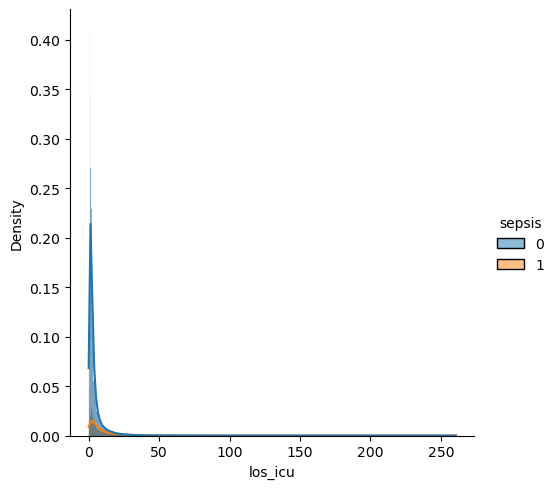

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


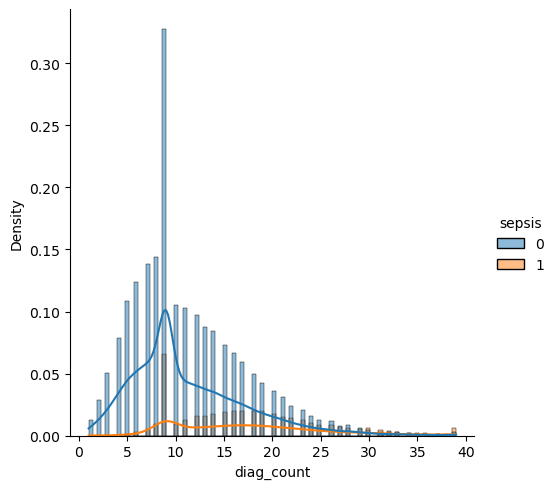

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


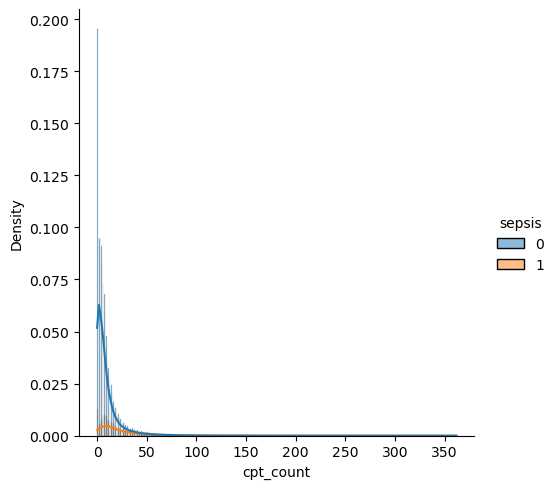

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


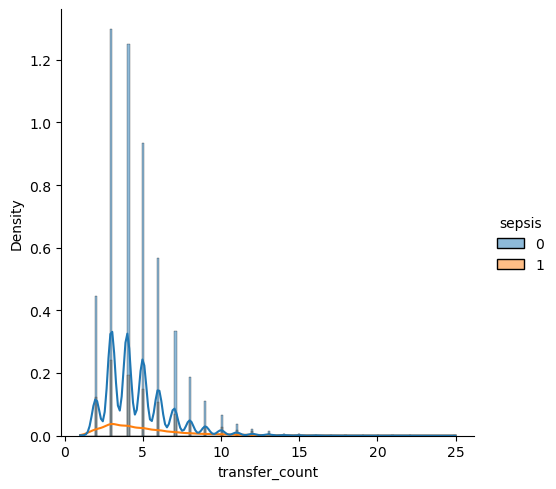

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


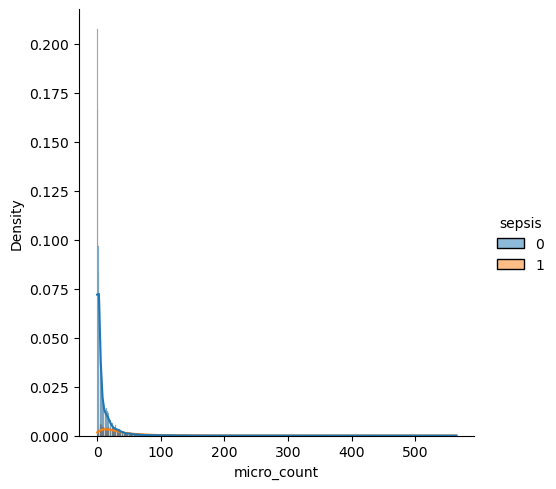

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


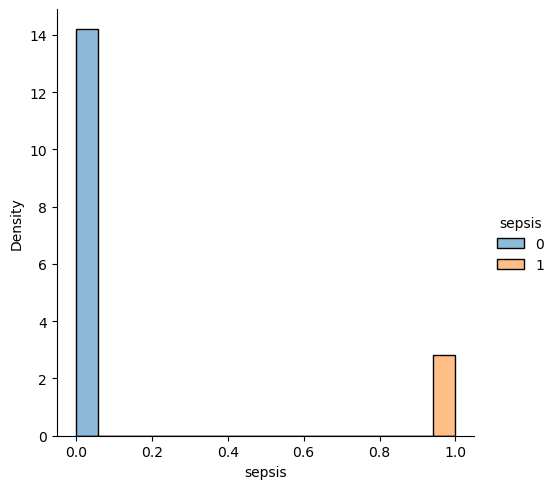

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


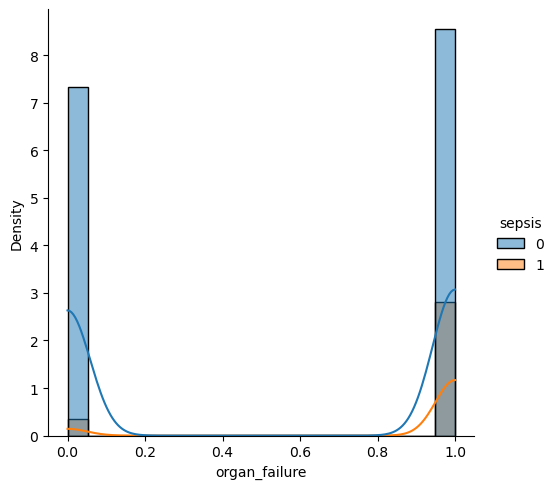

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


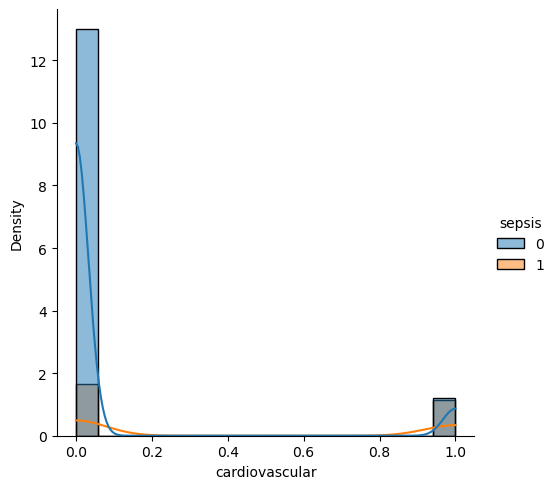

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


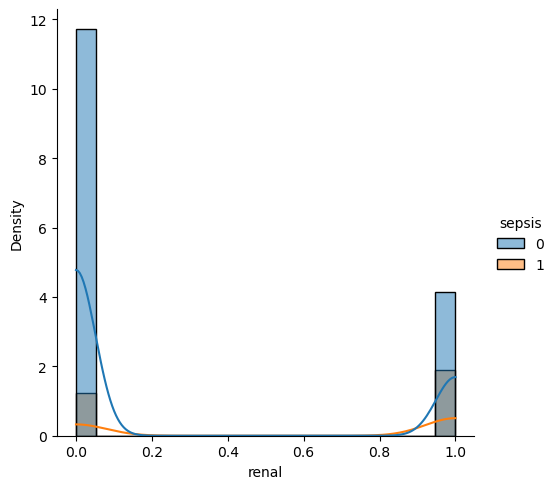

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


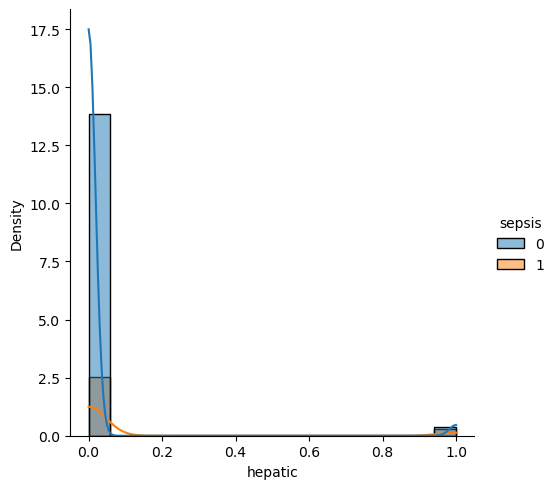

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


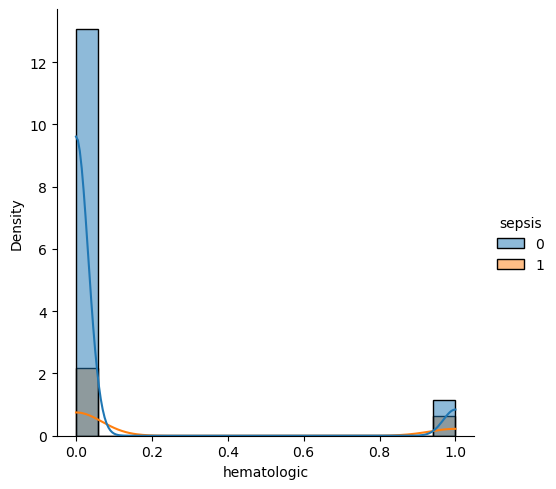

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


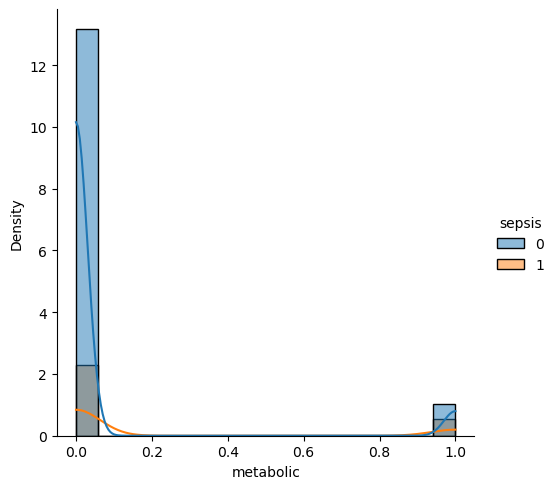

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


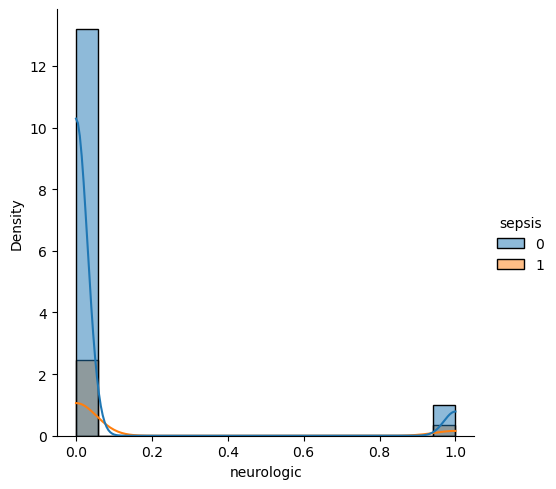

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


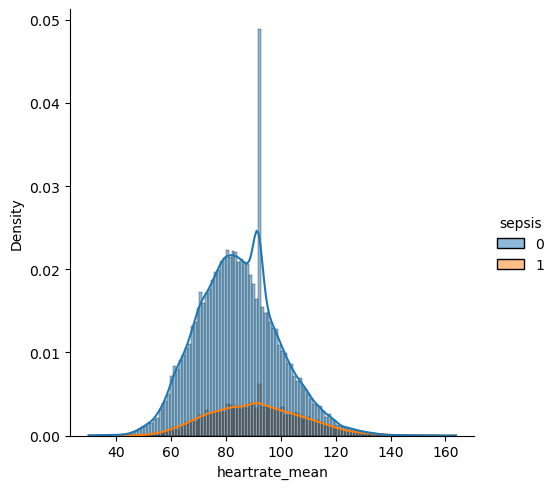

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


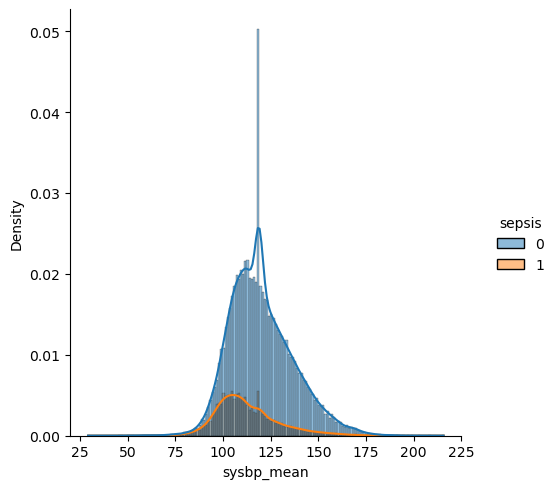

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


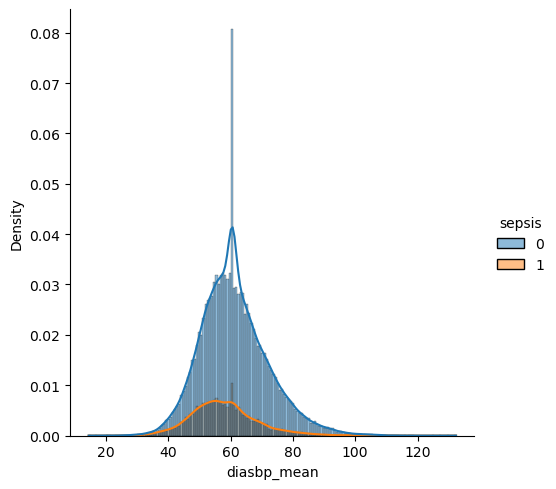

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


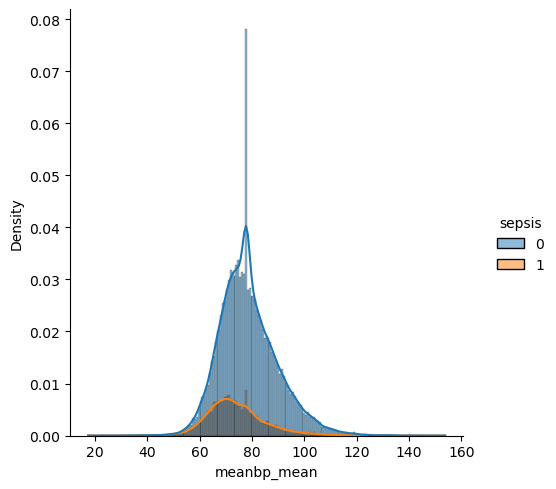

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


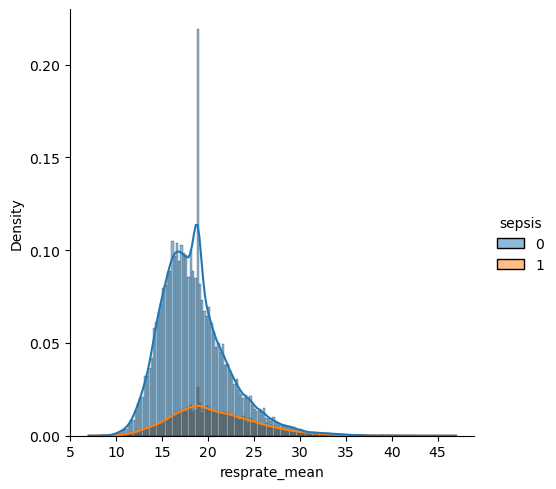

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


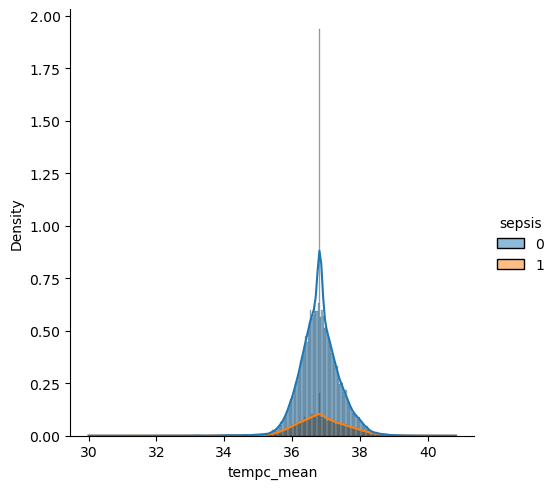

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


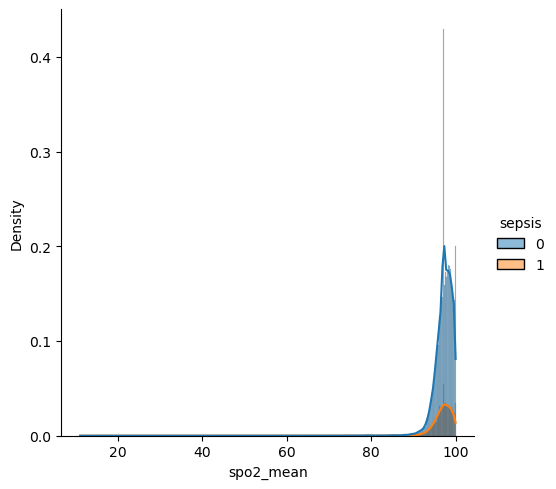

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


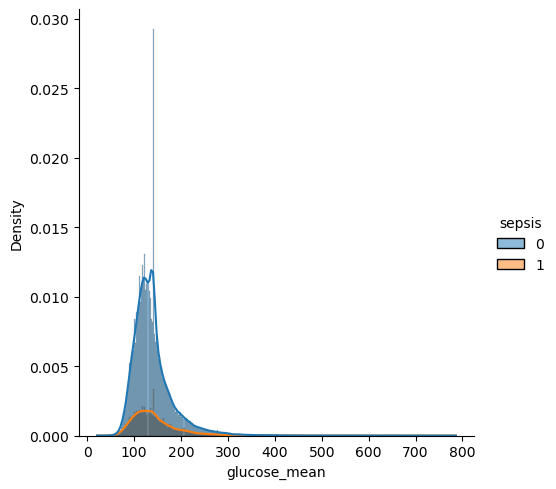

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


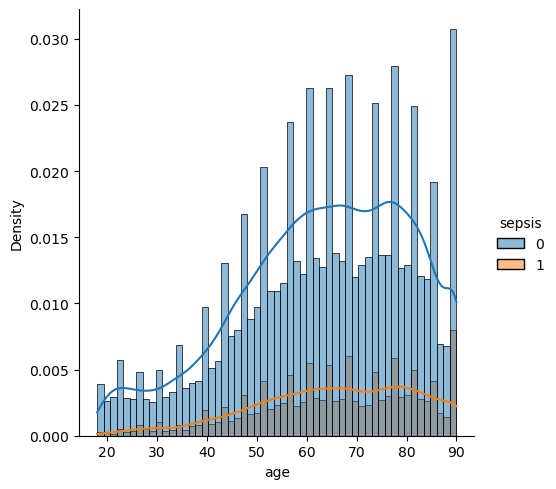

C:\Users\amr_e\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


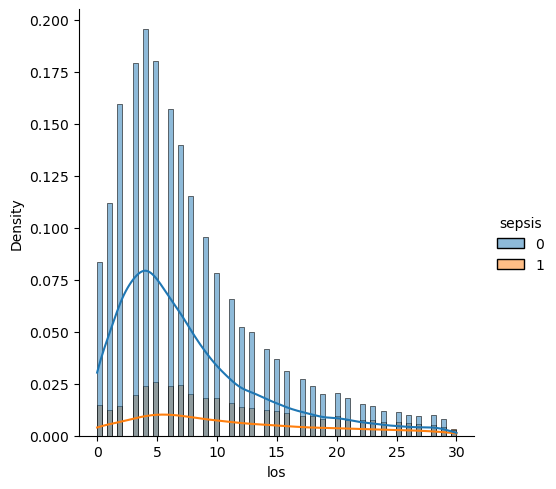

LinAlgError: The data appears to lie in a lower-dimensional subspace of the space in which it is expressed. This has resulted in a singular data covariance matrix, which cannot be treated using the algorithms implemented in `gaussian_kde`. Consider performing principle component analysis / dimensionality reduction and using `gaussian_kde` with the transformed data.

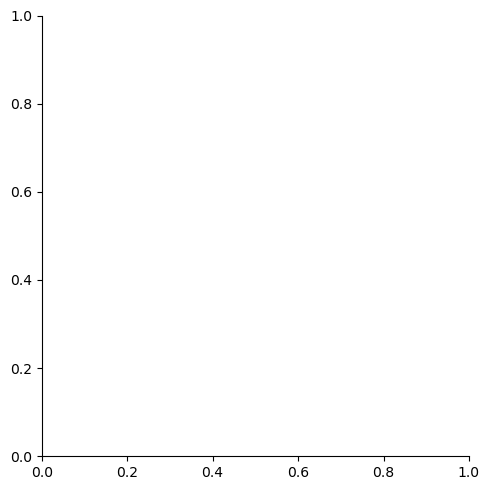

In [89]:
numerical_features = [
    'los_icu', 'diag_count', 'cpt_count', 'transfer_count', 'micro_count', 
    'sepsis', 'organ_failure', 'cardiovascular', 'renal', 'hepatic', 
    'hematologic', 'metabolic', 'neurologic', 'heartrate_mean', 'sysbp_mean', 
    'diasbp_mean', 'meanbp_mean', 'resprate_mean', 'tempc_mean', 'spo2_mean', 
    'glucose_mean', 'age', 'los', 'adult', 'diag_count_day', 'cpt_count_day', 
    'transfer_count_day', 'micro_count_day'
]
for col_name in numerical_features:
    sns.displot(data=df, x=col_name, hue='sepsis', stat='density', kde=True)
    plt.show()


### Setup

In [95]:
df.head()

,subject_id,hadm_id,admission_type,admittime,dischtime,deathtime,IN_HOSP_DEATH,diagnosis,marital_status,insurance,...,micro_count_day,admission_type_ELECTIVE,admission_type_EMERGENCY,admission_type_NEWBORN,admission_type_URGENT,gender_f,ethnicity_WHITE,ethnicity_BLACK/AFRICAN AMERICAN,ethnicity_UNKNOWN/NOT SPECIFIED,ethnicity_others
0,23804,100014,ELECTIVE,2111-03-05 03:42:00,2111-03-05 19:00:00,NaN,0,RIGHT SHOULDER ADHESIVE CAPSULITIS/SDA,SINGLE,Medicaid,...,0.000000,1,0,0,0,1,1,0,0,0
1,68591,100016,EMERGENCY,2188-05-24 13:06:00,2188-05-30 17:16:00,NaN,0,PNEUMONIA,SINGLE,Medicare,...,0.833333,0,1,0,0,0,1,0,0,0
2,9973,100020,EMERGENCY,2142-11-30 01:53:00,2142-12-10 16:32:00,NaN,0,HYPONATREMIA,MARRIED,Private,...,0.700000,0,1,0,0,0,1,0,0,0
3,29971,100021,EMERGENCY,2109-08-17 10:55:00,2109-10-16 11:15:00,NaN,0,BILATERAL ANKLE FX; NEW AFLUTTER,MARRIED,Medicaid,...,1.620690,0,1,0,0,0,0,0,0,1
4,29971,100021,EMERGENCY,2109-08-17 10:55:00,2109-10-16 11:15:00,NaN,0,BILATERAL ANKLE FX; NEW AFLUTTER,MARRIED,Medicaid,...,1.620690,0,1,0,0,0,0,0,0,1


In [96]:
df.columns


Index(['subject_id', 'hadm_id', 'admission_type', 'admittime', 'dischtime',
       'deathtime', 'IN_HOSP_DEATH', 'diagnosis', 'marital_status',
       'insurance', 'language', 'religion', 'ethnicity', 'gender', 'dob',
       'los_icu', 'callout_count', 'diag_count', 'pres_count', 'proc_count',
       'cpt_count', 'lab_count', 'inputs_cv_count', 'inputs_mv_count',
       'output_count', 'transfer_count', 'micro_count', 'sepsis',
       'organ_failure', 'cardiovascular', 'renal', 'hepatic', 'hematologic',
       'metabolic', 'neurologic', 'heartrate_min', 'heartrate_max',
       'heartrate_mean', 'sysbp_min', 'heartrate_min-2', 'heartrate_max-2',
       'heartrate_mean-2', 'sysbp_min-2', 'sysbp_max', 'sysbp_mean',
       'diasbp_min', 'diasbp_max', 'diasbp_mean', 'meanbp_min', 'meanbp_max',
       'meanbp_mean', 'resprate_min', 'resprate_max', 'resprate_mean',
       'tempc_min', 'tempc_max', 'tempc_mean', 'spo2_min', 'spo2_max',
       'spo2_mean', 'glucose_min', 'glucose_max', 'glucose

In [97]:
features_list = [
    'los_icu', 'organ_failure', 'cardiovascular', 'renal', 'hepatic', 'hematologic', 'metabolic', 'neurologic',
    'heartrate_mean', 'sysbp_mean', 'diasbp_mean', 'meanbp_mean', 'resprate_mean', 'tempc_mean', 'spo2_mean', 
    'glucose_mean', 'age', 'los', 'gender_f', 'ethnicity_WHITE', 'ethnicity_BLACK/AFRICAN AMERICAN',
    'ethnicity_UNKNOWN/NOT SPECIFIED', 'ethnicity_others', 'admission_type_ELECTIVE', 'admission_type_EMERGENCY', 
    'admission_type_NEWBORN', 'admission_type_URGENT'
]
len(features_list)

27

In [98]:
# Check for missing features or target column
missing_features = set(features_list) - set(df.columns)
missing_target = 'sepsis' not in df.columns

if missing_features:
    print("Missing features:", missing_features)
if missing_target:
    print("Missing target column 'sepsis'")


In [99]:
X = df[features_list] 
y = df['sepsis']


### Train-test Split
- Help mitigate overfitting (model learns to fit the noise and error terms of the data) while we train machine learning models
- Allow to report an unbiased performance metric using data unseen by the model
- A 70-30 or 80-20 split is usually the most common.


In [100]:
# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(
    X,              # Features (input variables)
    y,              # Target variable
    test_size=0.3,  # 30% of data belongs to the test set
    random_state=1, # Ensure the split is the same across different devices for illustrative purposes
    stratify=y      # Ensure the number of positive examples in the train and test sets are similar
)


In [101]:
X_train.shape


(37945, 27)

In [102]:
X_test.shape


(16263, 27)

#### Logistic Regression
In this example, we would be utilizing the package package Scikit-learn heavily for modelling. In Scikit-learn, the general flow can be simplified as follows:

1. Specify a model to be trained
- Choose a type of model based on your task and dataset. A full list of available models in the package can be found here.
- Set the hyperparameters of the model.
- Assign the model to a variable.

2. Train the model
- Call the .fit() function using your cleaned train dataset.
3. Make predictions
- Call the .predict() function using your cleaned test dataset.


### Model Training and Prediction

In [103]:
# 1. Specify a model to be trained 
model_lr = LogisticRegression(random_state = 1, n_jobs = -1)


In [104]:
from sklearn.impute import SimpleImputer

# Instantiate the imputer with a strategy (e.g., mean, median, etc.)
imputer = SimpleImputer(strategy='mean')

# Fit the imputer on the training data and transform both training and testing data
X_train = imputer.fit_transform(X_train)
X_test = imputer.transform(X_test)



In [105]:
# 2. Train the model 
model_lr.fit(X_train, y_train)

LogisticRegression(n_jobs=-1, random_state=1)

In [106]:
# 3. Make predictions 
y_pred_lr = model_lr.predict(X_test) 
y_pred_lr

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [107]:
model_lr.predict_proba(X_test)
# the two columns represent the prob of 0 and 1 respectively


array([[0.96404954, 0.03595046],
       [0.96851496, 0.03148504],
       [0.97951447, 0.02048553],
       ...,
       [0.76683738, 0.23316262],
       [0.74555828, 0.25444172],
       [0.99020986, 0.00979014]])

In [109]:
dfoutput = model_lr.predict_proba(X_test)

##### Evaluation
There are several metrics for evaluating the binary classification performances. 
In general, F1-score, being the harmonic mean of precision and recall, is the most common metric for these kind of machine learning problems.

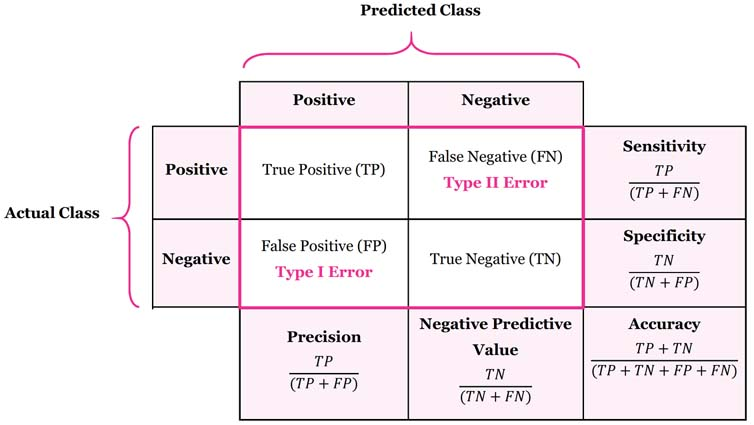

In [234]:
#Model Accuracy
accuracy_score(y_test, y_pred_lr)

0.8560536186435467

In [235]:
print(classification_report(y_test, y_pred_lr))

              precision    recall  f1-score   support

           0       0.87      0.97      0.92     13577
           1       0.64      0.30      0.40      2686

    accuracy                           0.86     16263
   macro avg       0.76      0.63      0.66     16263
weighted avg       0.84      0.86      0.83     16263



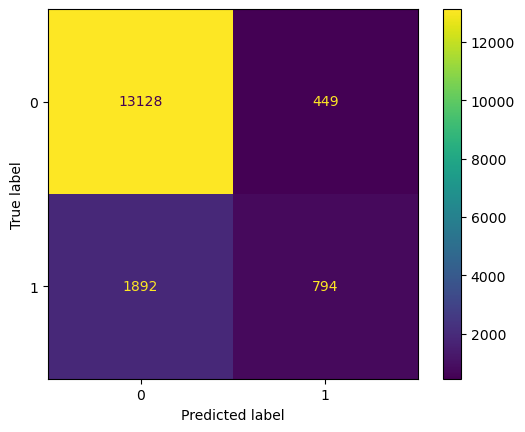

In [112]:
ConfusionMatrixDisplay.from_estimator(model_lr, X_test, y_test, values_format = 'd')
plt.show()

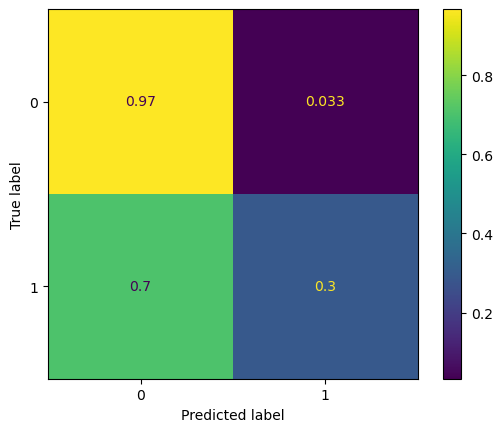

In [113]:
ConfusionMatrixDisplay.from_estimator(model_lr, X_test, y_test, normalize = 'true')
plt.show()

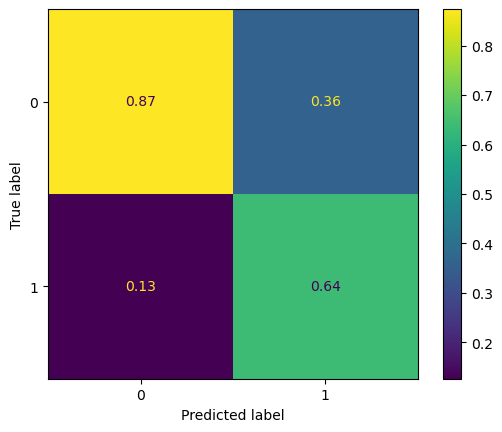

In [114]:
# precision-related metrics 
ConfusionMatrixDisplay.from_estimator(model_lr, X_test, y_test, normalize = 'pred')
plt.show()

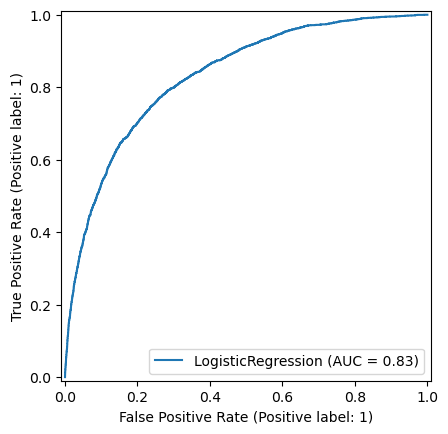

In [115]:
from sklearn.metrics import RocCurveDisplay
RocCurveDisplay.from_estimator(model_lr, X_test, y_test) 
plt.show()


##### Observations
- Despite achieving an accuracy of 92.6%, the overall F1-score is approximately 48%. This high accuracy is primarily attributed to class imbalance, with the model correctly predicting the majority class (SEPSIS == 0) most of the time.

- Furthermore, the recall for positive examples is only 34%, indicating that the model successfully detects only around one-third of those who died during their hospital stay.

### Random Forest Model


##### Model Training and Prediction
Define the configuration/hyperparameters of a random forest model. Here we specify that the model contains 200 decision trees.


In [116]:
model_rf1 = RandomForestClassifier(n_estimators = 200, random_state = 1, n_jobs = -1)


In [117]:
model_rf1.fit(X_train, y_train)


RandomForestClassifier(n_estimators=200, n_jobs=-1, random_state=1)

In [118]:
y_pred_rf1 = model_rf1.predict(X_test)

##### Evaluation

In [119]:
print(classification_report(y_test, y_pred_rf1))


              precision    recall  f1-score   support

           0       0.88      0.97      0.92     13577
           1       0.66      0.32      0.43      2686

    accuracy                           0.86     16263
   macro avg       0.77      0.64      0.67     16263
weighted avg       0.84      0.86      0.84     16263



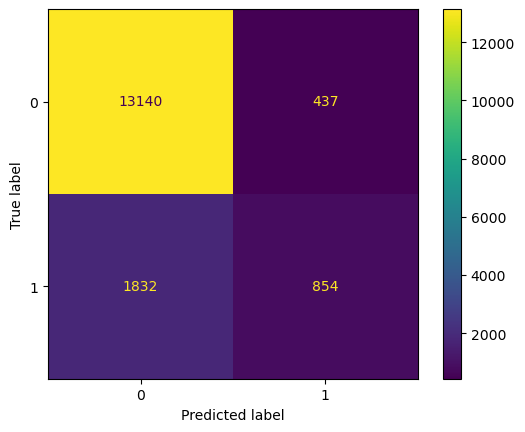

In [121]:
ConfusionMatrixDisplay.from_estimator(model_rf1, X_test, y_test, values_format = 'd')
plt.show()


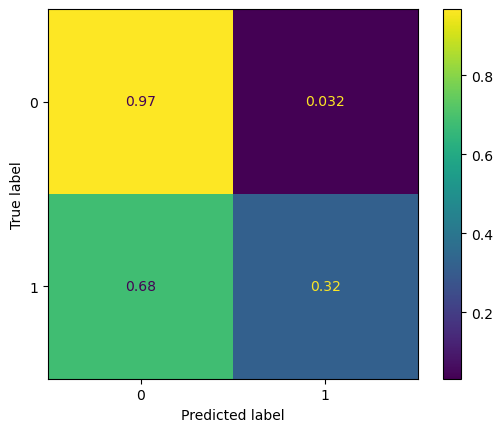

In [123]:
ConfusionMatrixDisplay.from_estimator(model_rf1, X_test, y_test, normalize = 'true')
plt.show()

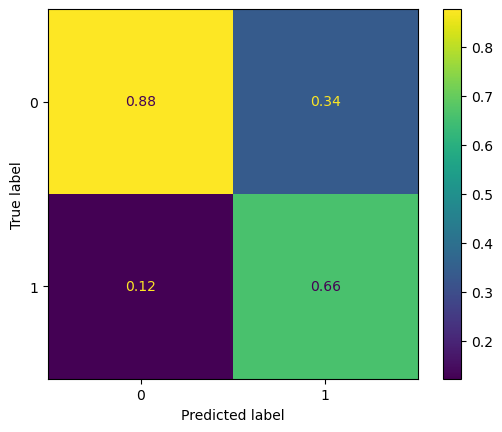

In [124]:
ConfusionMatrixDisplay.from_estimator(model_rf1, X_test, y_test, normalize = 'pred')
plt.show()

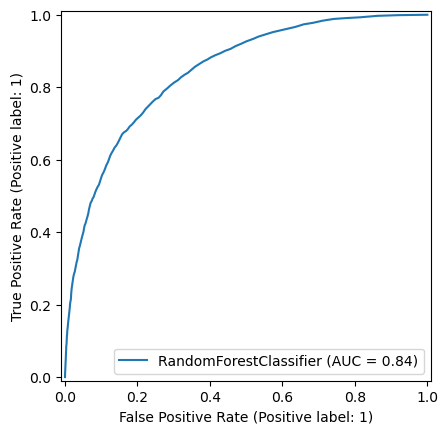

In [125]:
RocCurveDisplay.from_estimator(model_rf1, X_test, y_test) 
plt.show()

#### Tuning Random Forest Model
Now, I try to tune the hyperparameters of the random forest model above based on cross-validation and grid search. 
I apply the GridSearchCV() function and specify a list of hyperparameters and their respective values to be tested. 
Models are trained for each combination of values and fold.
The best performing set of hyperparameters across all folds would then be reported and used.

In [126]:
# A set of hyperparameters and their respective values to be tested
param_grid = {
    'n_estimators': [100, 200, 300],  # Number of decision trees in the forest
    'max_depth': [10, 40, None],       # Maximum depth of each tree. None means no specific limit.
    'class_weight': ['balanced', None] # Weight of each sample. None means equal weight, 'balanced' would put more weight on the less represented classes
}


In [127]:
grid_search_rf = GridSearchCV(
    estimator=RandomForestClassifier(random_state=1, n_jobs=-1),  # Define type of model to be tuned
    param_grid=param_grid,  # Hyperparameters to be tested
    cv=3,  # 3-fold cross-validation
    scoring='f1',  # Metric to be optimized
    n_jobs=-1,
    verbose=2
)


In [128]:
grid_search_rf.fit(X_train, y_train)  # This would take 10 to 15 minutes to run
# This could take even longer depending on the number of hyperparameters to be tested,
# number of folds, or the size of the dataset


Fitting 3 folds for each of 18 candidates, totalling 54 fits


GridSearchCV(cv=3, estimator=RandomForestClassifier(n_jobs=-1, random_state=1),
             n_jobs=-1,
             param_grid={'class_weight': ['balanced', None],
                         'max_depth': [10, 40, None],
                         'n_estimators': [100, 200, 300]},
             scoring='f1', verbose=2)

##### Tuning Results

In [129]:
grid_search_rf.best_params_

{'class_weight': 'balanced', 'max_depth': 10, 'n_estimators': 200}

Retrieve the best performing model using .best_estimator_ and save it as a seperate variable.

In [130]:
model_rf2 = grid_search_rf.best_estimator_

In [131]:
model_rf2 

RandomForestClassifier(class_weight='balanced', max_depth=10, n_estimators=200,
                       n_jobs=-1, random_state=1)

In [132]:
pd.DataFrame(grid_search_rf.cv_results_)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_class_weight,param_max_depth,param_n_estimators,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,5.201493,3.426042,3.842390,0.473370,balanced,10,100,"{'class_weight': 'balanced', 'max_depth': 10, ...",0.526470,0.521011,0.524796,0.524092,0.002283,3
1,28.161476,1.661178,4.489075,0.202091,balanced,10,200,"{'class_weight': 'balanced', 'max_depth': 10, ...",0.527513,0.521078,0.528476,0.525689,0.003284,1
2,43.165852,3.458419,4.830576,0.709959,balanced,10,300,"{'class_weight': 'balanced', 'max_depth': 10, ...",0.527824,0.520736,0.527430,0.525330,0.003253,2
3,25.687227,2.160908,4.209538,0.475661,balanced,40,100,"{'class_weight': 'balanced', 'max_depth': 40, ...",0.372158,0.377281,0.348927,0.366122,0.012337,18
4,48.608676,0.319520,4.824575,0.628431,balanced,40,200,"{'class_weight': 'balanced', 'max_depth': 40, ...",0.386560,0.380199,0.350914,0.372558,0.015523,13
5,72.399843,0.183484,4.758053,0.302739,balanced,40,300,"{'class_weight': 'balanced', 'max_depth': 40, ...",0.384455,0.380723,0.348927,0.371368,0.015941,15
6,28.679092,1.667597,3.318380,0.611323,balanced,None,100,"{'class_weight': 'balanced', 'max_depth': None...",0.374126,0.377281,0.350544,0.367317,0.011930,17
7,50.206630,0.763104,4.575394,0.997590,balanced,None,200,"{'class_weight': 'balanced', 'max_depth': None...",0.384589,0.380199,0.351826,0.372205,0.014521,14
8,66.274942,1.937492,5.207566,0.796936,balanced,None,300,"{'class_weight': 'balanced', 'max_depth': None...",0.385308,0.380723,0.347061,0.371031,0.017052,16
9,19.573956,2.074705,3.576627,1.131384,None,10,100,"{'class_weight': None, 'max_depth': 10, 'n_est...",0.399588,0.402712,0.366168,0.389489,0.016540,12


### Evaluation

In [133]:
y_pred_rf2 = model_rf2.predict(X_test)

In [134]:
print(classification_report(y_test, y_pred_rf2))


              precision    recall  f1-score   support

           0       0.93      0.80      0.86     13577
           1       0.41      0.70      0.52      2686

    accuracy                           0.79     16263
   macro avg       0.67      0.75      0.69     16263
weighted avg       0.85      0.79      0.81     16263



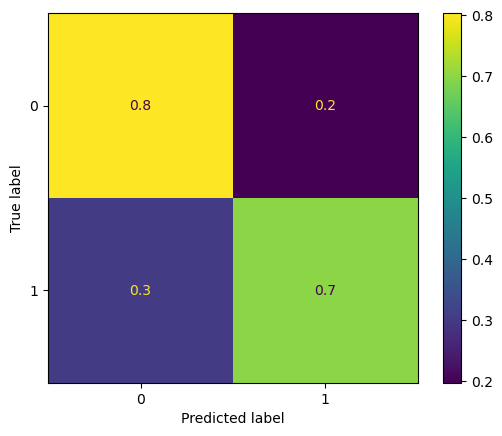

In [135]:
ConfusionMatrixDisplay.from_estimator(model_rf2, X_test, y_test, normalize = 'true')
plt.show()

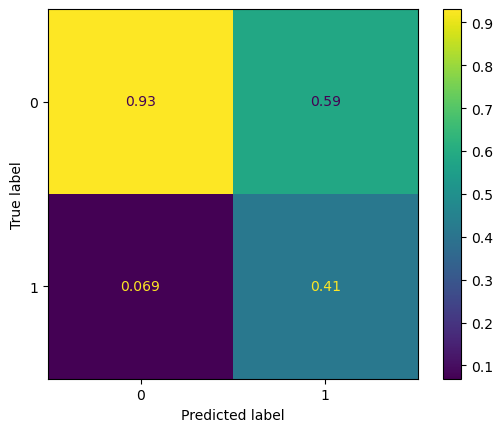

In [136]:
#precision 
ConfusionMatrixDisplay.from_estimator(model_rf2, X_test, y_test, normalize = 'pred')
plt.show()

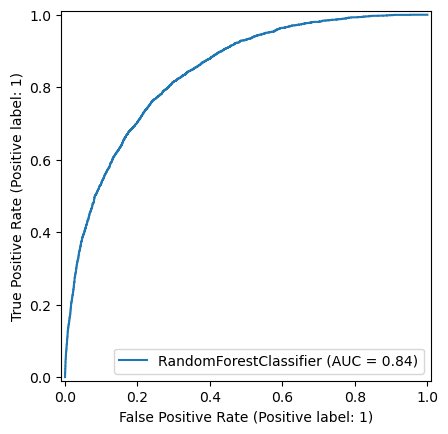

In [137]:
RocCurveDisplay.from_estimator(model_rf2, X_test, y_test) 
plt.show()

In [138]:
model_rf2_importance = pd.Series(model_rf2.feature_importances_, index = features_list) 
model_rf2_importance


los_icu                             0.122017
organ_failure                       0.130908
cardiovascular                      0.136131
renal                               0.106747
hepatic                             0.003649
hematologic                         0.013933
metabolic                           0.006952
neurologic                          0.001749
heartrate_mean                      0.046348
sysbp_mean                          0.070569
diasbp_mean                         0.028424
meanbp_mean                         0.049538
resprate_mean                       0.074002
tempc_mean                          0.033032
spo2_mean                           0.023404
glucose_mean                        0.024871
age                                 0.021524
los                                 0.058247
gender_f                            0.002870
ethnicity_WHITE                     0.002338
ethnicity_BLACK/AFRICAN AMERICAN    0.001839
ethnicity_UNKNOWN/NOT SPECIFIED     0.002019
ethnicity_